In [2]:
from pathlib import Path
import dask.dataframe as dd
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from main import *

### Engineer Features

| Feature Column | Description | Datatype |
| - | - | - |
| **Electrical System Features** |
| volt1_mean | Mean main bus voltage during flight | float |
| volt1_std | Standard deviation of main bus voltage | float |
| volt1_min | Minimum main bus voltage | float |
| volt1_max | Maximum main bus voltage | float |
| volt1_p25 | 25th percentile of main bus voltage | float |
| volt1_p75 | 75th percentile of main bus voltage | float |
| volt2_mean | Mean standby bus voltage during flight | float |
| volt2_std | Standard deviation of standby bus voltage | float |
| volt2_min | Minimum standby bus voltage | float |
| volt2_p25 | 25th percentile of standby bus voltage | float |
| volt2_p75 | 75th percentile of standby bus voltage | float |
| amp1_mean | Mean current on main battery | float |
| amp1_std | Standard deviation of main battery current | float |
| amp1_min | Minimum main battery current (max discharge) | float |
| amp1_p25 | 25th percentile of main battery current | float |
| amp1_p75 | 75th percentile of main battery current | float |
| amp2_mean | Mean current on standby battery | float |
| amp2_std | Standard deviation of standby battery current | float |
| amp2_p25 | 25th percentile of standby battery current | float |
| amp2_p75 | 75th percentile of standby battery current | float |
| **Fuel System Features** |
| FQtyL_mean | Mean left fuel quantity | float |
| FQtyL_start | Initial left fuel quantity | float |
| FQtyL_end | Final left fuel quantity | float |
| FQtyL_consumed | Total left fuel consumed (start - end) | float |
| FQtyL_rate | Rate of left fuel consumption (consumed/duration) | float |
| FQtyL_p25 | 25th percentile of left fuel quantity | float |
| FQtyL_p75 | 75th percentile of left fuel quantity | float |
| FQtyR_mean | Mean right fuel quantity | float |
| FQtyR_start | Initial right fuel quantity | float |
| FQtyR_end | Final right fuel quantity | float |
| FQtyR_consumed | Total right fuel consumed (start - end) | float |
| FQtyR_rate | Rate of right fuel consumption (consumed/duration) | float |
| FQtyR_p25 | 25th percentile of right fuel quantity | float |
| FQtyR_p75 | 75th percentile of right fuel quantity | float |
| fuel_imbalance_mean | Mean absolute difference between left/right tanks | float |
| fuel_imbalance_max | Maximum fuel imbalance during flight | float |
| E1_FFlow_mean | Mean engine fuel flow rate | float |
| E1_FFlow_std | Standard deviation of fuel flow rate | float |
| E1_FFlow_max | Maximum fuel flow rate | float |
| E1_FFlow_p25 | 25th percentile of fuel flow rate | float |
| E1_FFlow_p75 | 75th percentile of fuel flow rate | float |
| **Engine Performance Features** |
| E1_RPM_mean | Mean engine RPM | float |
| E1_RPM_std | Standard deviation of engine RPM | float |
| E1_RPM_max | Maximum engine RPM | float |
| E1_RPM_p25 | 25th percentile of engine RPM | float |
| E1_RPM_p75 | 75th percentile of engine RPM | float |
| E1_OilT_mean | Mean engine oil temperature | float |
| E1_OilT_std | Standard deviation of oil temperature | float |
| E1_OilT_max | Maximum oil temperature | float |
| E1_OilT_rate | Rate of oil temperature change (max-min)/duration | float |
| E1_OilT_p25 | 25th percentile of oil temperature | float |
| E1_OilT_p75 | 75th percentile of oil temperature | float |
| E1_OilP_mean | Mean engine oil pressure | float |
| E1_OilP_std | Standard deviation of oil pressure | float |
| E1_OilP_min | Minimum oil pressure | float |
| E1_OilP_p25 | 25th percentile of oil pressure | float |
| E1_OilP_p75 | 75th percentile of oil pressure | float |
| **Cylinder Head Temperature Features** |
| E1_CHT_mean_all | Mean of all 4 cylinder head temperatures | float |
| E1_CHT_max_all | Maximum CHT across all cylinders | float |
| E1_CHT_std_all | Standard deviation of CHT across all cylinders | float |
| E1_CHT_spread_mean | Mean spread between hottest and coolest cylinder | float |
| E1_CHT_rate_max | Maximum rate of CHT change across all cylinders | float |
| E1_CHT1_mean | Mean 1st cylinder head temperature | float |
| E1_CHT1_p25 | 25th percentile of 1st cylinder head temperature | float |
| E1_CHT1_p75 | 75th percentile of 1st cylinder head temperature | float |
| E1_CHT2_mean | Mean 2nd cylinder head temperature | float |
| E1_CHT2_p25 | 25th percentile of 2nd cylinder head temperature | float |
| E1_CHT2_p75 | 75th percentile of 2nd cylinder head temperature | float |
| E1_CHT3_mean | Mean 3rd cylinder head temperature | float |
| E1_CHT3_p25 | 25th percentile of 3rd cylinder head temperature | float |
| E1_CHT3_p75 | 75th percentile of 3rd cylinder head temperature | float |
| E1_CHT4_mean | Mean 4th cylinder head temperature | float |
| E1_CHT4_p25 | 25th percentile of 4th cylinder head temperature | float |
| E1_CHT4_p75 | 75th percentile of 4th cylinder head temperature | float |
| **Exhaust Gas Temperature Features** |
| E1_EGT_mean_all | Mean of all 4 exhaust gas temperatures | float |
| E1_EGT_max_all | Maximum EGT across all cylinders | float |
| E1_EGT_std_all | Standard deviation of EGT across all cylinders | float |
| E1_EGT_spread_mean | Mean spread between highest and lowest EGT | float |
| E1_EGT_rate_max | Maximum rate of EGT change across all cylinders | float |
| E1_EGT1_mean | Mean 1st exhaust gas temperature | float |
| E1_EGT1_p25 | 25th percentile of 1st exhaust gas temperature | float |
| E1_EGT1_p75 | 75th percentile of 1st exhaust gas temperature | float |
| E1_EGT2_mean | Mean 2nd exhaust gas temperature | float |
| E1_EGT2_p25 | 25th percentile of 2nd exhaust gas temperature | float |
| E1_EGT2_p75 | 75th percentile of 2nd exhaust gas temperature | float |
| E1_EGT3_mean | Mean 3rd exhaust gas temperature | float |
| E1_EGT3_p25 | 25th percentile of 3rd exhaust gas temperature | float |
| E1_EGT3_p75 | 75th percentile of 3rd exhaust gas temperature | float |
| E1_EGT4_mean | Mean 4th exhaust gas temperature | float |
| E1_EGT4_p25 | 25th percentile of 4th exhaust gas temperature | float |
| E1_EGT4_p75 | 75th percentile of 4th exhaust gas temperature | float |
| **Flight Dynamics Features** |
| OAT_mean | Mean outside air temperature | float |
| OAT_std | Standard deviation of outside air temperature | float |
| OAT_p25 | 25th percentile of outside air temperature | float |
| OAT_p75 | 75th percentile of outside air temperature | float |
| IAS_mean | Mean indicated airspeed | float |
| IAS_std | Standard deviation of indicated airspeed | float |
| IAS_max | Maximum indicated airspeed | float |
| IAS_p25 | 25th percentile of indicated airspeed | float |
| IAS_p75 | 75th percentile of indicated airspeed | float |
| IAS_rate_mean | Mean rate of airspeed change | float |
| VSpd_mean | Mean vertical speed | float |
| VSpd_std | Standard deviation of vertical speed | float |
| VSpd_max | Maximum climb rate | float |
| VSpd_min | Maximum descent rate (most negative) | float |
| VSpd_p25 | 25th percentile of vertical speed | float |
| VSpd_p75 | 75th percentile of vertical speed | float |
| NormAc_mean | Mean normal acceleration (g-loading) | float |
| NormAc_std | Standard deviation of normal acceleration | float |
| NormAc_max | Maximum normal acceleration | float |
| NormAc_min | Minimum normal acceleration | float |
| NormAc_p25 | 25th percentile of normal acceleration | float |
| NormAc_p75 | 75th percentile of normal acceleration | float |
| AltMSL_mean | Mean altitude | float |
| AltMSL_max | Maximum altitude reached | float |
| AltMSL_min | Minimum altitude during flight | float |
| AltMSL_range | Altitude range (max - min) | float |
| AltMSL_p25 | 25th percentile of altitude | float |
| AltMSL_p75 | 75th percentile of altitude | float |
| AltMSL_rate_mean | Mean rate of altitude change (climb/descent rate) | float |
| **Temporal Features** |
| flight_id | Flight record primary key, represents a single flight | int |
| before_after | Whether a flight occurred before or after a maintenance action | str |
| date_diff | Days before or after maintenance | int |
| flight_length | Duration of flight in seconds | float |
| label | Maintenance issue, 36 unique issues | str |
| cluster | Target label class | str |
| hierarchy | Maintenance issue category, NaN is other, 5 unique groups | str |
| number_flights_before | The nth flight before maintenance, -1 is N/A, 0 is immediately before | int |


In [ ]:
PROJECT_DIR, ALL_FLIGHTS_DIR = getPaths()

In [ ]:
flight_header_df = loadFlightHeader(ALL_FLIGHTS_DIR)
flight_header_df.head()

In [5]:
# Get all flight_ids
flight_ids = flight_header_df.index
len(flight_ids)

28935

In [7]:
def get_flight_features(flight_id: pd.DataFrame) -> dict[str, int | str]:
    """Returns flight identifying features including flight_id and cluster"""
    return {
        "flight_id": flight_id,
        "before_after": flight_header_df.loc[flight_id, "before_after"],
        "date_diff": flight_header_df.loc[flight_id, "date_diff"],
        "flight_length": flight_header_df.loc[flight_id, "flight_length"],
        "label": flight_header_df.loc[flight_id, "label"],
        "num_flights_before": flight_header_df.loc[flight_id, "date_diff"],
    }

In [ ]:
# Electrical System Features
def get_electrical_features(
    flight_df: pd.DataFrame,
) -> dict[str, float]:
    # dropna
    volt1 = flight_df["volt1"].dropna()
    volt2 = flight_df["volt2"].dropna()
    amp1 = flight_df["amp1"].dropna()
    amp2 = flight_df["amp2"].dropna()
    return {
        # volt1 features
        "volt1_mean": volt1.mean(),
        "volt1_std": volt1.std(),
        "volt1_min": volt1.min(),
        "volt1_max": volt1.max(),
        "volt1_p25": volt1.quantile(0.25),
        "volt1_p75": volt1.quantile(0.75),
        # volt2 features
        "volt2_mean": volt2.dropna().mean(),
        "volt2_std": volt2.std(),
        "volt2_min": volt2.min(),
        "volt2_max": volt2.max(),
        "volt2_p25": volt2.quantile(0.25),
        "volt2_p75": volt2.quantile(0.75),
        # amp1 features
        "amp1_mean": amp1.mean(),
        "amp1_std": amp1.std(),
        "amp1_min": amp1.min(),
        "amp1_max": amp1.max(),
        "amp1_p25": amp1.quantile(0.25),
        "amp1_p75": amp1.quantile(0.75),
        # amp2 features
        "amp2_mean": amp2.mean(),
        "amp2_std": amp2.std(),
        "amp2_min": amp2.min(),
        "amp2_max": amp2.max(),
        "amp2_p25": amp2.quantile(0.25),
        "amp2_p75": amp2.quantile(0.75),
    }

In [ ]:
flight_df = get_flight_df(ALL_FLIGHTS_DIR, 1)
# get_electrical_features(flight_df)

In [ ]:
# Fuel System Features
def get_fuel_features(flight_df: pd.DataFrame) -> dict[str, float]:
    fqtyl = flight_df["FQtyL"].dropna()
    fqtyr = flight_df["FQtyR"].dropna()
    fflow = flight_df["E1 FFlow"].dropna()
    flight_length = len(flight_df)
    return {
        # FQtyL features
        "FQtyL_mean": fqtyl.mean(),
        "FQtyL_std": fqtyl.std(),
        "FQtyL_min": fqtyl.min(),
        "FQtyL_max": fqtyl.max(),
        "FQtyL_p25": fqtyl.quantile(0.25),
        "FQtyL_p75": fqtyl.quantile(0.75),
        "FQtyL_start": fqtyl.iloc[0] if fqtyl.any() else np.nan,
        "FQtyL_end": fqtyl.iloc[-1] if fqtyl.any() else np.nan,
        "FQtyL_consumed": fqtyl.iloc[0] - fqtyl.iloc[-1] if fqtyl.any() else np.nan,
        "FQtyL_rate": (fqtyl.iloc[0] - fqtyl.iloc[-1]) / flight_length
        if fqtyl.any()
        else np.nan,
        # FQtyR features
        "FQtyR_mean": fqtyr.mean(),
        "FQtyR_std": fqtyr.std(),
        "FQtyR_min": fqtyr.min(),
        "FQtyR_max": fqtyr.max(),
        "FQtyR_p25": fqtyr.quantile(0.25),
        "FQtyR_p75": fqtyr.quantile(0.75),
        "FQtyR_start": fqtyr.iloc[0] if fqtyr.any() else np.nan,
        "FQtyR_end": fqtyr.iloc[-1] if fqtyr.any() else np.nan,
        "FQtyR_consumed": fqtyr.iloc[0] - fqtyr.iloc[-1] if fqtyr.any() else np.nan,
        "FQtyR_rate": (fqtyr.iloc[0] - fqtyr.iloc[-1]) / len(flight_df)
        if fqtyr.any()
        else np.nan,
        # Fuel imbalance features
        "fuel_imbalance_mean": (fqtyl - fqtyr).abs().mean(),
        "fuel_imbalance_max": (fqtyl - fqtyr).abs().max(),
        # E1 FFlow features
        "E1_FFlow_mean": fflow.mean(),
        "E1_FFlow_std": fflow.std(),
        "E1_FFlow_max": fflow.max(),
        "E1_FFlow_min": fflow.min(),
        "E1_FFlow_p25": fflow.quantile(0.25),
        "E1_FFlow_p75": fflow.quantile(0.75),
    }

In [ ]:
# get_fuel_features(get_flight_df(ALL_FLIGHTS_DIR, 3))
flight_df = get_flight_df(ALL_FLIGHTS_DIR, 30)

In [12]:
# Engine Features
def get_engine_features(flight_df: pd.DataFrame) -> dict[str, float]:
    rpm = flight_df["E1 RPM"].dropna()
    oil_temp = flight_df["E1 OilT"].dropna()
    oil_press = flight_df["E1 OilP"].dropna()
    return {
        # E1 RPM features
        "E1_RPM_mean": rpm.mean(),
        "E1_RPM_std": rpm.std(),
        "E1_RPM_min": rpm.min(),
        "E1_RPM_max": rpm.max(),
        "E1_RPM_p25": rpm.quantile(0.25),
        "E1_RPM_p75": rpm.quantile(0.75),
        # E1 OilT features
        "E1_OilT_mean": oil_temp.mean(),
        "E1_OilT_std": oil_temp.std(),
        "E1_OilT_min": oil_temp.min(),
        "E1_OilT_max": oil_temp.max(),
        "E1_OilT_rate": (oil_temp.max() - oil_temp.min()) / len(flight_df),
        "E1_OilT_p25": oil_temp.quantile(0.25),
        "E1_OilT_p75": oil_temp.quantile(0.75),
        # E1 OilP features
        "E1_OilP_mean": oil_press.mean(),
        "E1_OilP_std": oil_press.std(),
        "E1_OilP_min": oil_press.min(),
        "E1_OilP_p25": oil_press.quantile(0.25),
        "E1_OilP_p75": oil_press.quantile(0.75),
    }

In [13]:
# get_engine_features(flight_df)

In [14]:
def get_cylinder_head_features(flight_df: pd.DataFrame) -> dict[str, float]:
    cht1 = flight_df["E1 CHT1"].dropna()
    cht2 = flight_df["E1 CHT2"].dropna()
    cht3 = flight_df["E1 CHT3"].dropna()
    cht4 = flight_df["E1 CHT4"].dropna()
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()

    return {
        # Aggregate CHT features across all cylinders
        "E1_CHT_mean_all": cht_all.mean().mean(),
        "E1_CHT_min_all": cht_all.min().min(),
        "E1_CHT_max_all": cht_all.max().max(),
        "E1_CHT_std_all": cht_all.std().std(),
        "E1_CHT_spread_mean": (cht_all.max(axis=1) - cht_all.min(axis=1)).mean(),
        "E1_CHT_rate_max": max(
            (cht1.max() - cht1.min()) / len(flight_df),
            (cht2.max() - cht2.min()) / len(flight_df),
            (cht3.max() - cht3.min()) / len(flight_df),
            (cht4.max() - cht4.min()) / len(flight_df),
        ),
        # CHT1 features
        "E1_CHT1_mean": cht1.mean(),
        "E1_CHT1_std": cht1.std(),
        "E1_CHT1_min": cht1.min(),
        "E1_CHT1_max": cht1.max(),
        "E1_CHT1_p25": cht1.quantile(0.25),
        "E1_CHT1_p75": cht1.quantile(0.75),
        # CHT2 features
        "E1_CHT2_mean": cht2.mean(),
        "E1_CHT2_std": cht2.std(),
        "E1_CHT2_min": cht2.min(),
        "E1_CHT2_max": cht2.max(),
        "E1_CHT2_p25": cht2.quantile(0.25),
        "E1_CHT2_p75": cht2.quantile(0.75),
        # CHT3 features
        "E1_CHT3_mean": cht3.mean(),
        "E1_CHT3_std": cht3.std(),
        "E1_CHT3_min": cht3.min(),
        "E1_CHT3_max": cht3.max(),
        "E1_CHT3_p25": cht3.quantile(0.25),
        "E1_CHT3_p75": cht3.quantile(0.75),
        # CHT4 features
        "E1_CHT4_mean": cht4.mean(),
        "E1_CHT4_std": cht4.std(),
        "E1_CHT4_min": cht4.min(),
        "E1_CHT4_max": cht4.max(),
        "E1_CHT4_p25": cht4.quantile(0.25),
        "E1_CHT4_p75": cht4.quantile(0.75),
    }

In [15]:
# get_cylinder_head_features(flight_df)

In [16]:
def get_exhaust_gas_features(flight_df: pd.DataFrame) -> dict[str, float]:
    egt1 = flight_df["E1 EGT1"].dropna()
    egt2 = flight_df["E1 EGT2"].dropna()
    egt3 = flight_df["E1 EGT3"].dropna()
    egt4 = flight_df["E1 EGT4"].dropna()
    egt_all = flight_df[["E1 EGT1", "E1 EGT2", "E1 EGT3", "E1 EGT4"]].dropna()

    return {
        # Aggregate EGT features across all cylinders
        "E1_EGT_mean_all": egt_all.mean().mean(),
        "E1_EGT_min_all": egt_all.min().min(),
        "E1_EGT_max_all": egt_all.max().max(),
        "E1_EGT_std_all": egt_all.std().std(),
        "E1_EGT_spread_mean": (egt_all.max(axis=1) - egt_all.min(axis=1)).mean(),
        "E1_EGT_rate_max": max(
            (egt1.max() - egt1.min()) / len(flight_df),
            (egt2.max() - egt2.min()) / len(flight_df),
            (egt3.max() - egt3.min()) / len(flight_df),
            (egt4.max() - egt4.min()) / len(flight_df),
        ),
        # EGT1 features
        "E1_EGT1_mean": egt1.mean(),
        "E1_EGT1_std": egt1.std(),
        "E1_EGT1_min": egt1.min(),
        "E1_EGT1_max": egt1.max(),
        "E1_EGT1_p25": egt1.quantile(0.25),
        "E1_EGT1_p75": egt1.quantile(0.75),
        # EGT2 features
        "E1_EGT2_mean": egt2.mean(),
        "E1_EGT2_std": egt2.std(),
        "E1_EGT2_min": egt2.min(),
        "E1_EGT2_max": egt2.max(),
        "E1_EGT2_p25": egt2.quantile(0.25),
        "E1_EGT2_p75": egt2.quantile(0.75),
        # EGT3 features
        "E1_EGT3_mean": egt3.mean(),
        "E1_EGT3_std": egt3.std(),
        "E1_EGT3_min": egt3.min(),
        "E1_EGT3_max": egt3.max(),
        "E1_EGT3_p25": egt3.quantile(0.25),
        "E1_EGT3_p75": egt3.quantile(0.75),
        # EGT4 features
        "E1_EGT4_mean": egt4.mean(),
        "E1_EGT4_std": egt4.std(),
        "E1_EGT4_min": egt4.min(),
        "E1_EGT4_max": egt4.max(),
        "E1_EGT4_p25": egt4.quantile(0.25),
        "E1_EGT4_p75": egt4.quantile(0.75),
    }

In [17]:
# get_exhaust_gas_features(flight_df)

In [18]:
def get_flight_dyn_features(flight_df: pd.DataFrame) -> dict[str, float]:
    oat = flight_df["OAT"].dropna()
    ias = flight_df["IAS"].dropna()
    vspd = flight_df["VSpd"].dropna()
    normac = flight_df["NormAc"].dropna()
    altmsl = flight_df["AltMSL"].dropna()

    return {
        # OAT features
        "OAT_mean": oat.mean(),
        "OAT_std": oat.std(),
        "OAT_min": oat.min(),
        "OAT_max": oat.max(),
        "OAT_p25": oat.quantile(0.25),
        "OAT_p75": oat.quantile(0.75),
        # IAS features
        "IAS_mean": ias.mean(),
        "IAS_std": ias.std(),
        "IAS_max": ias.max(),
        "IAS_min": ias.min(),
        "IAS_p25": ias.quantile(0.25),
        "IAS_p75": ias.quantile(0.75),
        "IAS_rate_mean": ias.diff().mean(),
        # VSpd features
        "VSpd_mean": vspd.mean(),
        "VSpd_std": vspd.std(),
        "VSpd_min": vspd.min(),
        "VSpd_max": vspd.max(),
        "VSpd_p25": vspd.quantile(0.25),
        "VSpd_p75": vspd.quantile(0.75),
        # NormAc features
        "NormAc_mean": normac.mean(),
        "NormAc_std": normac.std(),
        "NormAc_min": normac.min(),
        "NormAc_max": normac.max(),
        "NormAc_p25": normac.quantile(0.25),
        "NormAc_p75": normac.quantile(0.75),
        # AltMSL features
        "AltMSL_mean": altmsl.mean(),
        "AltMSL_std": altmsl.std(),
        "AltMSL_min": altmsl.min(),
        "AltMSL_max": altmsl.max(),
        "AltMSL_range": altmsl.max() - altmsl.min(),
        "AltMSL_p25": altmsl.quantile(0.25),
        "AltMSL_p75": altmsl.quantile(0.75),
        "AltMSL_rate_mean": altmsl.diff().mean(),
    }

In [64]:
# get_flight_dyn_features(flight_df)

In [ ]:
def get_all_features(flight_id: int) -> dict[str, float | int | str]:
    flight_df = get_flight_df(ALL_FLIGHTS_DIR, flight_id)
    return {
        **get_flight_features(flight_id),
        **get_electrical_features(flight_df),
        **get_fuel_features(flight_df),
        **get_engine_features(flight_df),
        **get_cylinder_head_features(flight_df),
        **get_exhaust_gas_features(flight_df),
        **get_flight_dyn_features(flight_df),
    }

In [170]:
# path for all_stats.parquet
all_stats_path = PROJECT_DIR / "data" / "all_stats.parquet"

In [ ]:
# ### Uncomment and run this cell to create all_stats.parquet ###
### Caution - takes hours! ###
# all_features = []
# for flight_id in flight_ids:
#     all_features.append(get_all_features(flight_id))

# df = pd.DataFrame(all_features)
# df.to_parquet(all_stats_path)

In [171]:
assert all_stats_path.exists()

all_stats_df = pd.read_parquet(all_stats_path)

In [173]:
all_stats_df.head()

,flight_id,before_after,date_diff,flight_length,label,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,...,NormAc_p25,NormAc_p75,AltMSL_mean,AltMSL_std,AltMSL_min,AltMSL_max,AltMSL_range,AltMSL_p25,AltMSL_p75,AltMSL_rate_mean
0,1,before,-1,4723.0,intake gasket leak/damage,-1,28.780796,4.712894e-02,28.7,29.3,...,-0.01,0.01,2764.796803,1616.009723,835.6,5162.4,4326.8,842.55,4048.9,0.000275
1,2,before,-2,4649.0,intake gasket leak/damage,-2,27.831276,7.633934e-01,25.0,28.2,...,-0.03,0.04,2205.734739,1287.575722,824.1,5261.6,4437.5,887.00,3509.8,-0.001678
2,3,same,0,40.0,intake gasket leak/damage,0,24.900000,3.600403e-15,24.9,24.9,...,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,before,0,14.0,intake gasket leak/damage,0,25.400000,3.697782e-15,25.4,25.4,...,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,same,0,683.0,intake gasket leak/damage,0,26.945095,1.271312e+00,24.6,28.1,...,-0.02,0.02,832.528006,5.235779,812.9,846.0,33.1,831.60,835.4,0.031571


In [ ]:
# add cluster column
label_cluster_map = {label: i for i, label in enumerate(all_stats_df["label"].unique())}
all_stats_df["cluster"] = all_stats_df["label"].map(label_cluster_map)
all_stats_df.head()

,flight_id,before_after,date_diff,flight_length,label,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,...,NormAc_p75,AltMSL_mean,AltMSL_std,AltMSL_min,AltMSL_max,AltMSL_range,AltMSL_p25,AltMSL_p75,AltMSL_rate_mean,cluster
0,1,before,-1,4723.0,intake gasket leak/damage,-1,28.780796,4.712894e-02,28.7,29.3,...,0.01,2764.796803,1616.009723,835.6,5162.4,4326.8,842.55,4048.9,0.000275,0
1,2,before,-2,4649.0,intake gasket leak/damage,-2,27.831276,7.633934e-01,25.0,28.2,...,0.04,2205.734739,1287.575722,824.1,5261.6,4437.5,887.00,3509.8,-0.001678,0
2,3,same,0,40.0,intake gasket leak/damage,0,24.900000,3.600403e-15,24.9,24.9,...,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,4,before,0,14.0,intake gasket leak/damage,0,25.400000,3.697782e-15,25.4,25.4,...,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,5,same,0,683.0,intake gasket leak/damage,0,26.945095,1.271312e+00,24.6,28.1,...,0.02,832.528006,5.235779,812.9,846.0,33.1,831.60,835.4,0.031571,0


### High Impact Features

In [ ]:
# focus only on highest impact labels
weighted_labels_path = PROJECT_DIR / "data" / "weighted_labels.csv"
assert weighted_labels_path.exists()

weighted_labels_df = pd.read_csv(weighted_labels_path, index_col=0)
# weighted_labels_df.head()
weighted_labels_df.sort_values(by="weight_risk_factor", ascending=False).head()

,label,count,cluster,price_usd,weight_norm,weight_total_impact,risk_factor,weight_risk_factor
9,engine failure/fire/time out,643,c_21,839.99,0.382277,540113.57,2.0,37271.599134
3,baffle crack/damage/loose/miss,1294,c_4,419.95,0.237344,543415.30,1.3,34472.789022
10,cylinder compression issue,617,c_13,795.00,0.362015,490515.00,1.7,29574.516259
0,intake gasket leak/damage,10140,c_28,4.50,0.500000,45630.00,1.3,27963.244769
7,engine run rough,670,c_24,839.99,0.383613,562793.30,1.4,27185.660955


In [243]:
# Identify Top Features
num_features = 4
sort_by = "weight_risk_factor"

features = (
    weighted_labels_df.sort_values(by=sort_by, ascending=False)["label"]
    .iloc[:num_features]
    .values
)
sorted(features)

['baffle crack/damage/loose/miss',
 'cylinder compression issue',
 'engine failure/fire/time out',
 'intake gasket leak/damage']

In [ ]:
# Filter select features
df_prime = all_stats_df[all_stats_df["label"].isin(features)]

# Split pre/post maintenance
pre_maintenance_df = df_prime[df_prime["before_after"] == "before"]
post_maintenance_df = df_prime[df_prime["before_after"] == "after"]

In [103]:
df_prime.shape

(12694, 170)

In [186]:
pre_maintenance_df.shape

(5327, 170)

In [187]:
post_maintenance_df.shape

(4545, 170)

In [188]:
df_prime.describe()

,flight_id,date_diff,flight_length,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,volt1_p25,volt1_p75,...,NormAc_p75,AltMSL_mean,AltMSL_std,AltMSL_min,AltMSL_max,AltMSL_range,AltMSL_p25,AltMSL_p75,AltMSL_rate_mean,cluster
count,12694.000000,12694.000000,12694.000000,12694.000000,12687.000000,12687.000000,12687.000000,12687.000000,12687.000000,12687.000000,...,11925.000000,11303.000000,11294.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11294.000000,12694.000000
mean,15616.342839,-0.000867,3814.650465,-0.000867,27.377527,0.417172,25.087554,27.623000,27.393214,27.554380,...,0.022849,2042.267801,938.715025,818.459489,3597.128231,2778.668743,1129.918265,2864.485548,-0.017461,4.894517
std,11006.707379,3.292570,3096.588521,3.292570,1.435701,0.378452,1.574253,1.461063,1.532523,1.469504,...,0.013934,1122.958505,735.025803,210.045890,2153.883913,2139.855515,723.125416,1761.753427,3.232114,11.083846
min,1.000000,-40.000000,12.000000,-40.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.040000,-70.216667,0.076795,-3239.100000,-53.300000,0.000000,-110.050000,-64.275000,-256.200000,0.000000
25%,4089.250000,-1.000000,403.000000,-1.000000,27.609097,0.104137,24.500000,28.100000,27.800000,28.000000,...,0.010000,886.377844,132.245367,819.200000,1338.000000,707.700000,838.500000,884.350000,-0.001133,0.000000
50%,20634.500000,0.000000,4323.000000,0.000000,27.907146,0.376745,24.900000,28.200000,28.000000,28.100000,...,0.020000,2014.393928,1029.752884,828.600000,3801.500000,2980.000000,842.500000,2939.700000,0.000543,0.000000
75%,24641.750000,1.000000,5750.750000,1.000000,28.042331,0.618097,25.400000,28.200000,28.100000,28.200000,...,0.030000,2636.654842,1431.138047,833.500000,5115.000000,4288.000000,1098.112500,3911.862500,0.003485,0.000000
max,32820.000000,67.000000,27253.000000,67.000000,30.546154,13.154237,30.500000,30.600000,30.500000,30.600000,...,0.170000,11346.534500,4303.197153,5782.400000,14100.000000,12960.400000,10631.350000,12988.100000,122.100000,35.000000


In [189]:
pre_maintenance_df.describe()

,flight_id,date_diff,flight_length,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,volt1_p25,volt1_p75,...,NormAc_p75,AltMSL_mean,AltMSL_std,AltMSL_min,AltMSL_max,AltMSL_range,AltMSL_p25,AltMSL_p75,AltMSL_rate_mean,cluster
count,5327.000000,5327.000000,5327.000000,5327.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,...,5058.000000,4795.000000,4793.000000,4795.000000,4795.000000,4795.000000,4795.000000,4795.000000,4793.000000,5327.000000
mean,15606.574620,-2.021776,4164.847944,-2.021776,27.430521,0.392746,25.135331,27.652742,27.464505,27.587068,...,0.023462,2133.873694,1024.500122,818.197018,3848.403837,3030.206820,1126.891032,3039.369505,-0.006075,5.024779
std,11043.237384,2.549454,2943.178046,2.549454,1.427125,0.345716,1.527602,1.466238,1.515197,1.454080,...,0.014098,1049.844655,698.220949,210.098759,2030.697296,2025.214398,634.678603,1672.507168,2.660047,11.178163
min,1.000000,-40.000000,12.000000,-40.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.040000,-70.216667,0.076795,-2918.400000,-53.300000,0.000000,-110.050000,-64.275000,-126.000000,0.000000
25%,4079.500000,-3.000000,1326.000000,-3.000000,27.698622,0.106190,24.500000,28.100000,27.900000,28.000000,...,0.020000,1140.567188,322.490316,820.400000,1741.100000,918.600000,839.500000,1497.250000,-0.001033,0.000000
50%,20676.000000,-1.000000,4636.000000,-1.000000,27.929985,0.362849,24.900000,28.200000,28.000000,28.100000,...,0.020000,2087.449928,1086.216525,829.300000,3994.700000,3166.200000,843.700000,3100.250000,0.000434,0.000000
75%,24699.500000,-1.000000,5831.500000,-1.000000,28.050685,0.584586,25.400000,28.200000,28.100000,28.200000,...,0.030000,2703.119944,1480.068281,833.900000,5220.800000,4391.650000,1119.787500,4030.950000,0.002548,0.000000
max,32817.000000,0.000000,20209.000000,0.000000,29.359613,12.044188,29.000000,29.700000,29.200000,29.500000,...,0.170000,7879.397758,3886.146189,5552.700000,10897.500000,10063.200000,7016.700000,10344.900000,122.100000,35.000000


In [190]:
post_maintenance_df.describe()

,flight_id,date_diff,flight_length,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,volt1_p25,volt1_p75,...,NormAc_p75,AltMSL_mean,AltMSL_std,AltMSL_min,AltMSL_max,AltMSL_range,AltMSL_p25,AltMSL_p75,AltMSL_rate_mean,cluster
count,4545.000000,4545.000000,4545.000000,4545.000000,4544.000000,4544.000000,4544.000000,4544.000000,4544.000000,4544.000000,...,4305.000000,4122.000000,4117.000000,4122.000000,4122.000000,4122.000000,4122.000000,4122.000000,4117.000000,4545.000000
mean,15741.905831,2.367217,4640.182178,2.367217,27.437233,0.388507,25.111818,27.657240,27.472667,27.586345,...,0.024767,2305.247283,1122.693938,829.645803,4143.663367,3314.017564,1223.626995,3285.380277,-0.079596,5.036744
std,11057.301673,3.502518,2982.740662,3.502518,1.442020,0.386440,1.650611,1.435827,1.538788,1.475391,...,0.014349,1141.811298,674.637676,213.074302,1995.525891,1970.557858,894.820110,1709.867903,4.224566,11.279332
min,7.000000,1.000000,12.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.010000,204.593548,0.083907,-3195.400000,554.100000,0.000000,-44.950000,544.000000,-256.200000,0.000000
25%,4077.000000,1.000000,2972.000000,1.000000,27.727733,0.097803,24.500000,28.100000,27.900000,28.000000,...,0.020000,1642.012394,779.875208,822.000000,3073.425000,2248.700000,840.200000,2083.262500,-0.000940,0.000000
50%,20695.000000,1.000000,4978.000000,1.000000,27.931072,0.357809,24.900000,28.200000,28.000000,28.100000,...,0.025000,2192.397670,1136.421910,829.800000,4168.150000,3341.950000,845.975000,3266.512500,0.000427,0.000000
75%,24723.000000,3.000000,6129.000000,3.000000,28.055496,0.575665,25.400000,28.200000,28.100000,28.200000,...,0.030000,2809.074428,1531.179347,834.000000,5371.025000,4547.425000,1203.362500,4211.487500,0.002205,0.000000
max,32820.000000,67.000000,27253.000000,67.000000,29.200898,13.154237,29.000000,29.600000,29.200000,29.300000,...,0.080000,11346.534500,4303.197153,5782.400000,14100.000000,12960.400000,10631.350000,12988.100000,15.000000,35.000000


### Visualize Features

In [191]:
def scatter_plot(
    pre_maintenance_df: pd.DataFrame,
    post_maintenance_df: pd.DataFrame,
    features: list[str],
) -> None:
    """Creates pre- and -post scatter plots colored by cluster"""
    # Color by cluster
    cmap = plt.cm.tab10
    alpha = 0.3

    # cluster to label map
    cluster_label_map = {cluster: label for label, cluster in label_cluster_map.items()}

    # drop na
    pre_maintenance_df = pre_maintenance_df[["cluster", *features]].dropna()
    post_maintenance_df = post_maintenance_df[["cluster", *features]].dropna()

    for feature in features:
        # 1 x 2 plot
        fig, axes = plt.subplots(1, 2)
        fig.suptitle(feature)

        # Pre-Mainteance
        ax = axes[0]
        ax.set_title("pre-maintenance")
        ax.set_xticks([])
        ax.set_ylabel(feature)

        ax.scatter(
            range(len(pre_maintenance_df["cluster"])),
            pre_maintenance_df[feature],
            c=pre_maintenance_df["cluster"],
            cmap=cmap,
            alpha=alpha,
        )

        # ax.axhline(y=pre_maintenance_df[feature].mean(), linestyle="--")

        # Post-Maintenance
        ax = axes[1]
        ax.set_title("post-maintenance")
        ax.set_xticks([])
        ax.set_ylabel(feature)

        ax.scatter(
            range(len(post_maintenance_df["cluster"])),
            post_maintenance_df[feature],
            c=post_maintenance_df["cluster"],
            cmap=cmap,
            alpha=alpha,
        )

        # ax.axhline(y=post_maintenance_df[feature].mean(), linestyle="--")

        # Legend
        unique_clusters = sorted(pre_maintenance_df["cluster"].unique())
        norm = plt.Normalize(
            vmin=pre_maintenance_df["cluster"].min(),
            vmax=pre_maintenance_df["cluster"].max(),
        )

        # Create legend handles with corresponding colors
        legend_handles = [
            mpatches.Patch(
                color=cmap(norm(cluster)), label=cluster_label_map[cluster], alpha=alpha
            )
            for cluster in unique_clusters
        ]

        # Add legend to the right of the figure
        ax.legend(
            handles=legend_handles,
            loc="upper left",
            bbox_to_anchor=(1, 1),
            # ncol=2,
            frameon=True,
        )

        fig.set_layout_engine("constrained")

In [179]:
def corr_heatmap(pre_maintenance_df, post_maintenance_df, features, width=7):
    """Plots correlation heatmap"""

    cmap = "vlag"
    fig, axes = plt.subplots(1, 2, figsize=(2 * width, width))

    # Pre-Maintenace
    ax = axes[0]
    sns.heatmap(pre_maintenance_df[features].dropna().corr(), cmap=cmap, ax=ax)

    # post-maintenace
    ax = axes[1]
    sns.heatmap(post_maintenance_df[features].dropna().corr(), cmap=cmap, ax=ax)

    fig.set_layout_engine("tight")

In [ ]:
def plot_two_features(
    pre_maintenance_df: pd.DataFrame,
    post_maintenance_df: pd.DataFrame,
    f1: str,
    f2: str,
) -> None:
    """Plots two features and the correlation. Drops NaN"""

    # Drop na
    pre_maintenance_df = pre_maintenance_df[[f1, f2]].dropna()
    post_maintenance_df = post_maintenance_df[[f1, f2]].dropna()

    # Pre-Maintenance
    fig, axes = plt.subplots(1, 2)
    ax = axes[0]
    sns.scatterplot(data=pre_maintenance_df, x=f1, y=f2, ax=ax)
    coeff = np.corrcoef(pre_maintenance_df[f1], pre_maintenance_df[f2])[0, 1]
    ax.set_title(f"Pre-Maintenance, $R^2={coeff**2:0.2f}$")

    # Post-Maintenance
    ax = axes[1]
    sns.scatterplot(data=post_maintenance_df, x=f1, y=f2, ax=ax)
    coeff = np.corrcoef(post_maintenance_df[f1], post_maintenance_df[f2])[0, 1]
    ax.set_title(f"Post-Maintenance, $R^2={coeff**2:0.2f}$")

    fig.set_layout_engine("constrained")

In [ ]:
def get_r2_corr(df: pd.DataFrame, features: list[str]) -> pd.DataFrame:
    """Returns dataframe with R**2 correlation"""
    # Look at upper tri
    corr_df = df[features].dropna().corr() ** 2
    upper_tri = corr_df.where(np.triu(np.ones(corr_df.shape), k=1).astype(bool))

    # append values
    data = []
    for (feature_1, feature_2), r2 in upper_tri.stack().items():
        # skip the same column stats
        column = "_".join(feature_1.split("_")[:-1])
        if feature_2.startswith(column):
            continue
        data.append({"feature_1": feature_1, "feature_2": feature_2, "r2": r2})

    return pd.DataFrame(data)

#### Electrical System Features

/tmp/ipykernel_72108/355777266.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2)


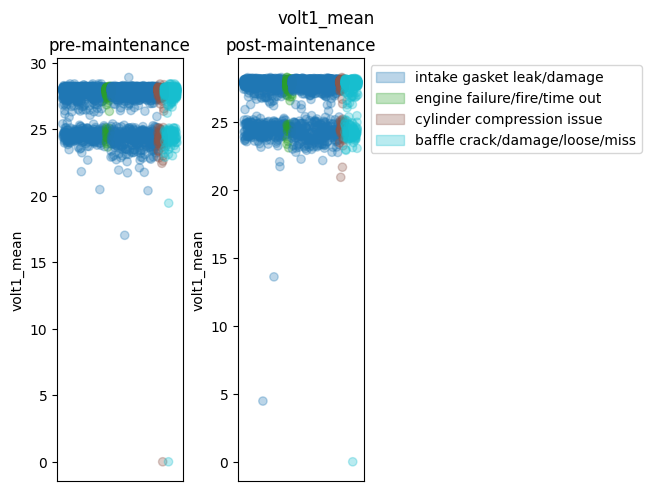

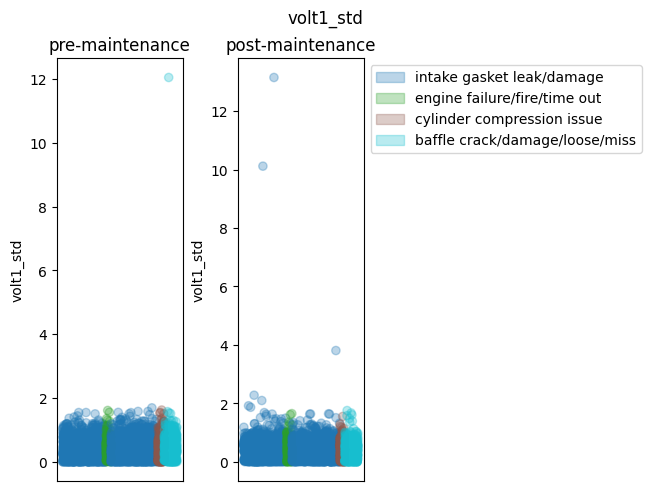

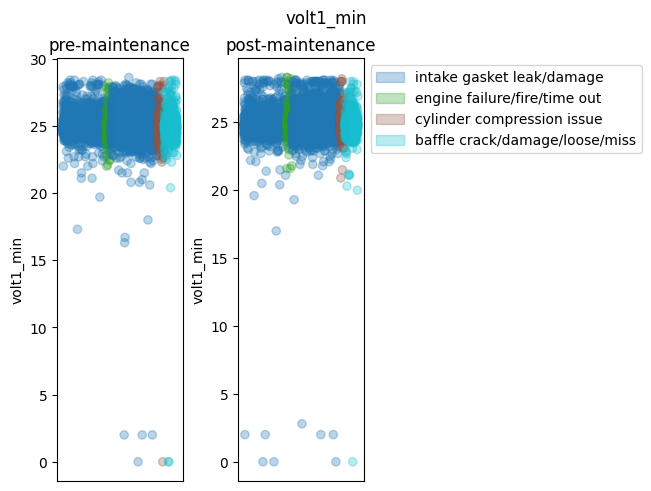

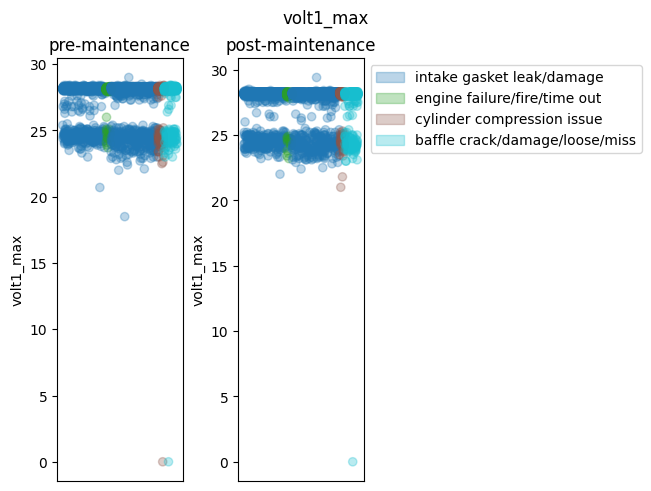

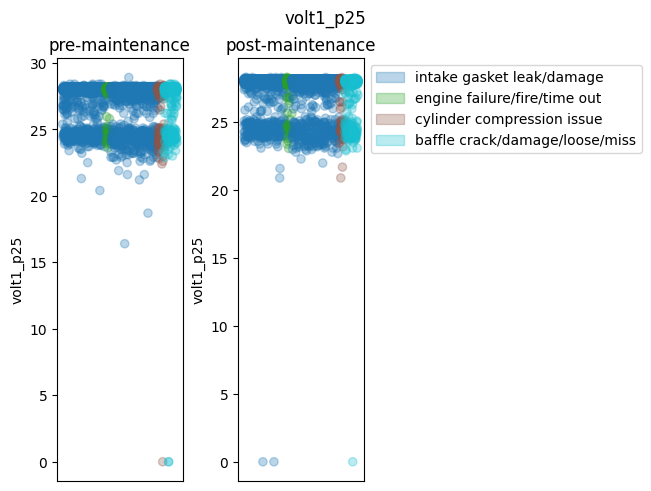

...

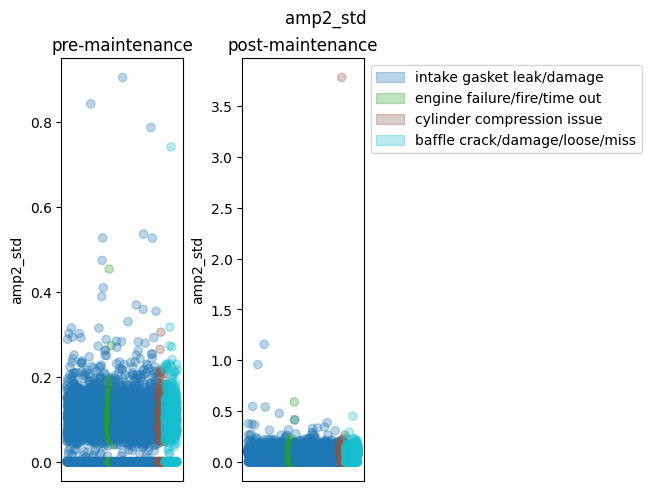

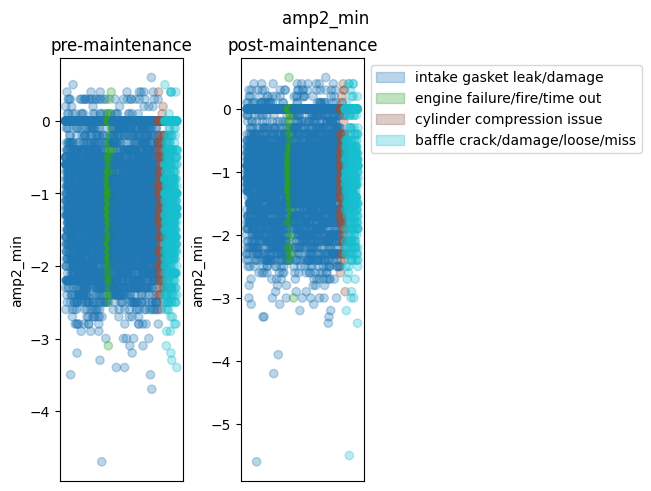

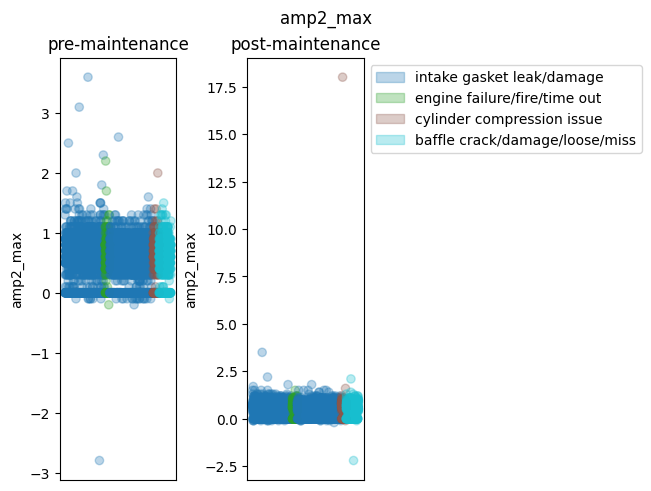

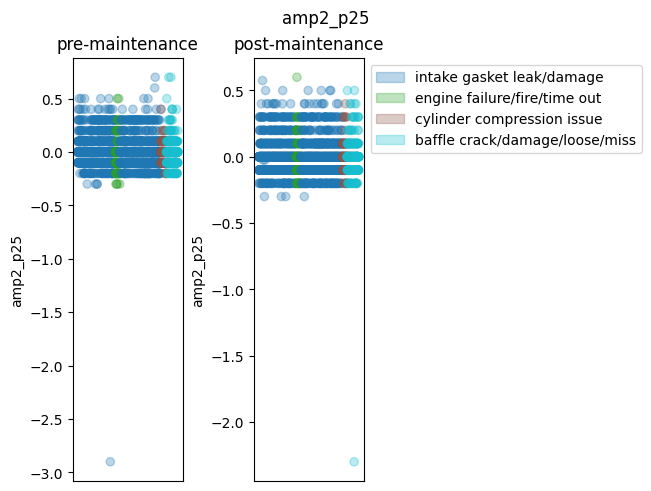

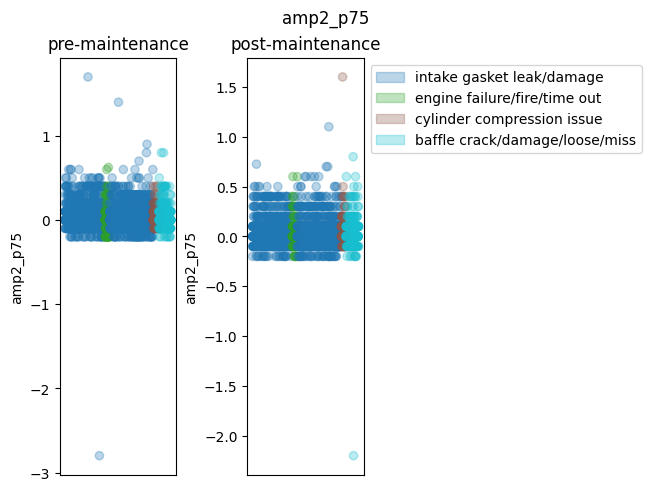

In [192]:
electrical_columns = get_electrical_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, electrical_columns)


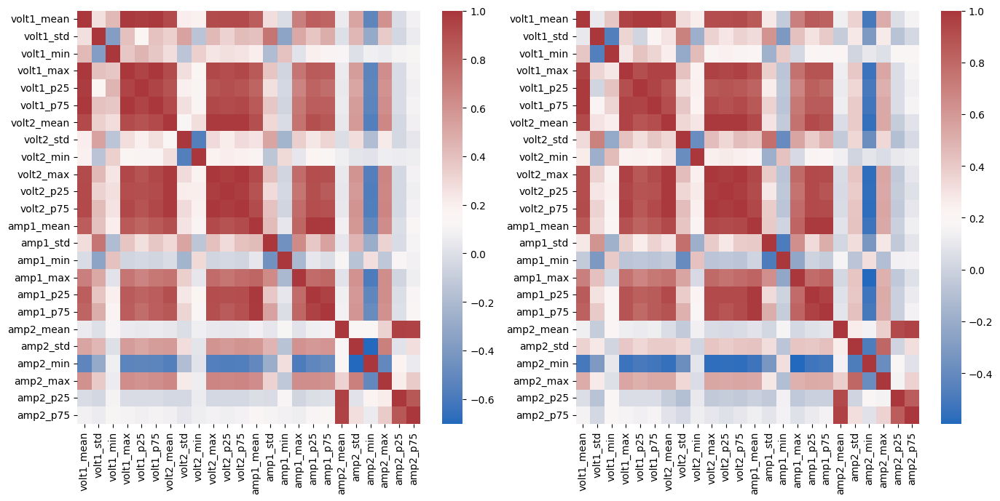

In [193]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, electrical_columns)

In [234]:
electrical_r2_df = get_r2_corr(pre_maintenance_df, electrical_columns)
electrical_r2_df.sort_values(by="r2", ascending=False).head()

,feature_1,feature_2,r2
57,volt1_max,volt2_max,0.864912
95,volt1_p75,volt2_p75,0.863935
59,volt1_max,volt2_p75,0.861446
93,volt1_p75,volt2_max,0.861307
0,volt1_mean,volt2_mean,0.840231


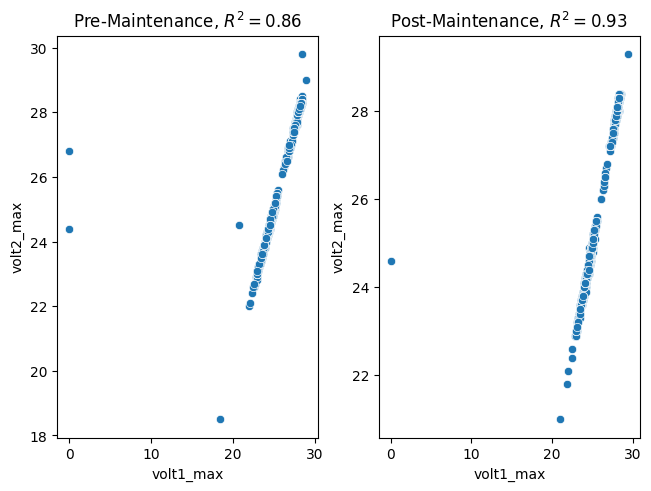

In [220]:
plot_two_features(pre_maintenance_df, post_maintenance_df, "volt1_max", "volt2_max")

#### Fuel System Features

/tmp/ipykernel_72108/699101256.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2)


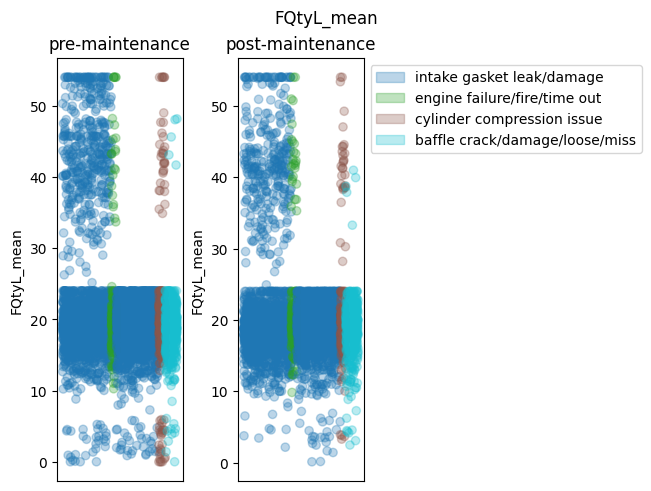

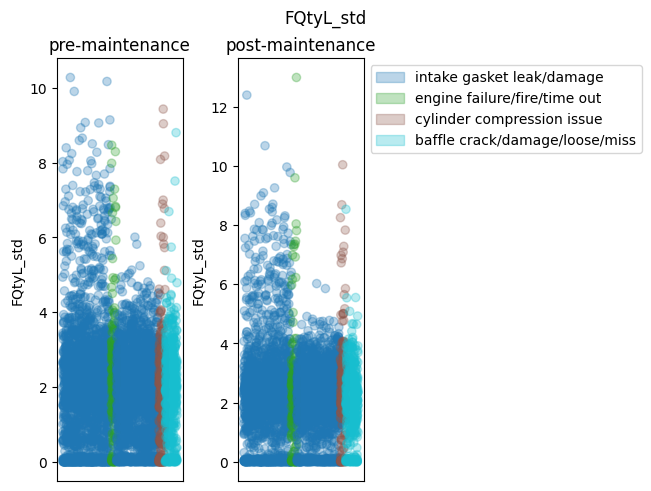

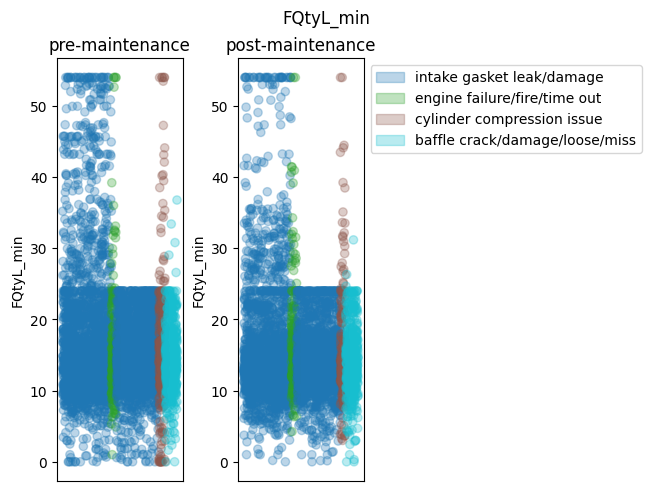

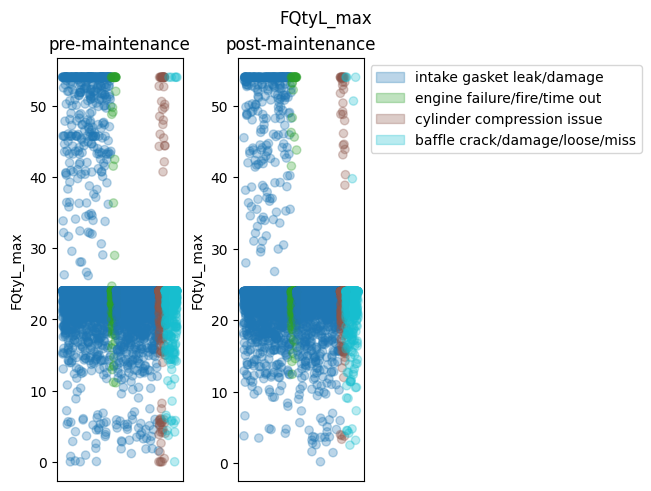

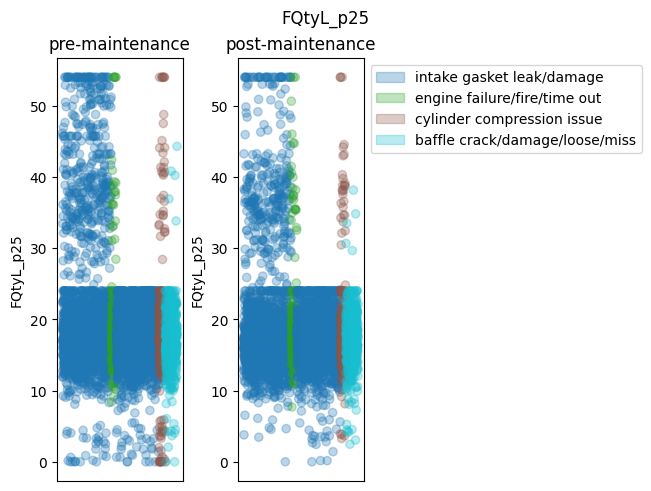

...

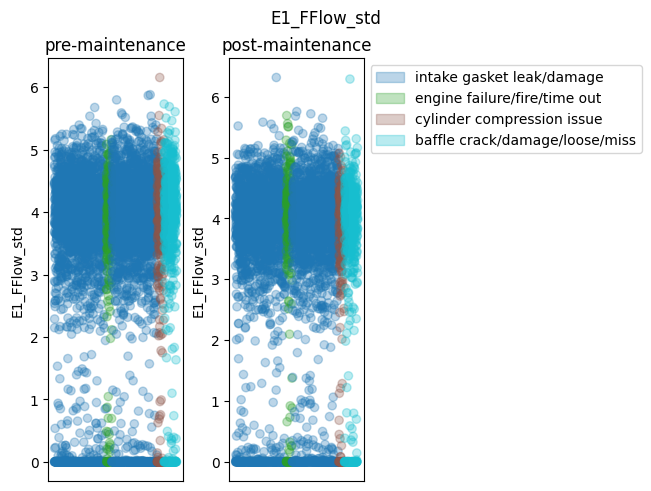

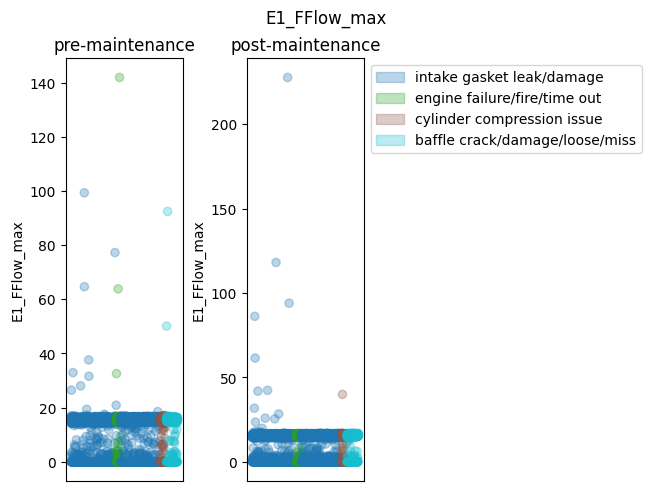

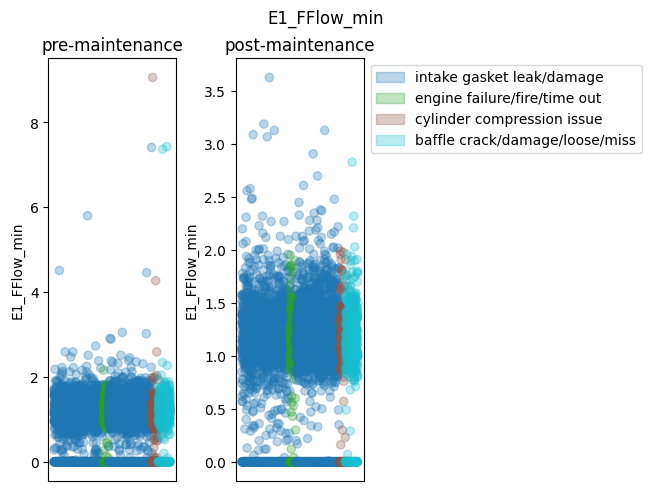

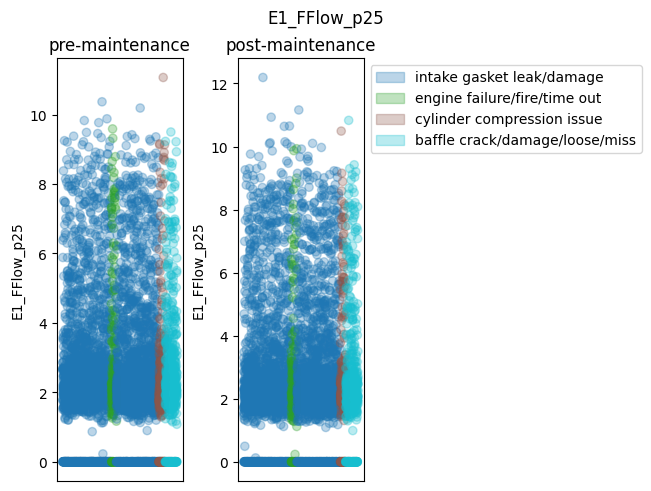

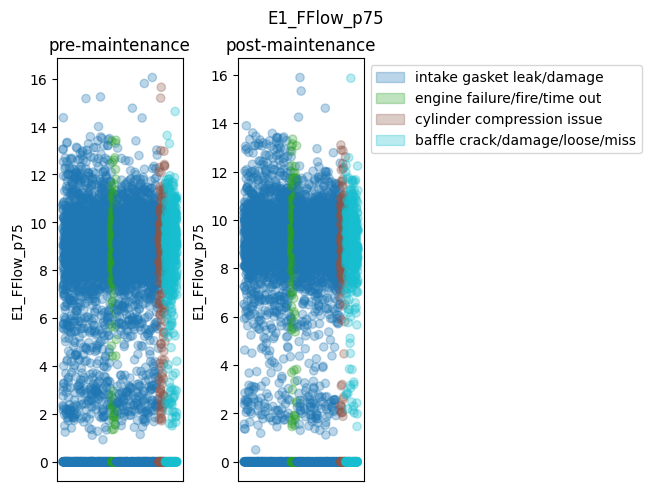

In [106]:
# Fuel System Features
fuel_system_columns = get_fuel_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, fuel_system_columns)

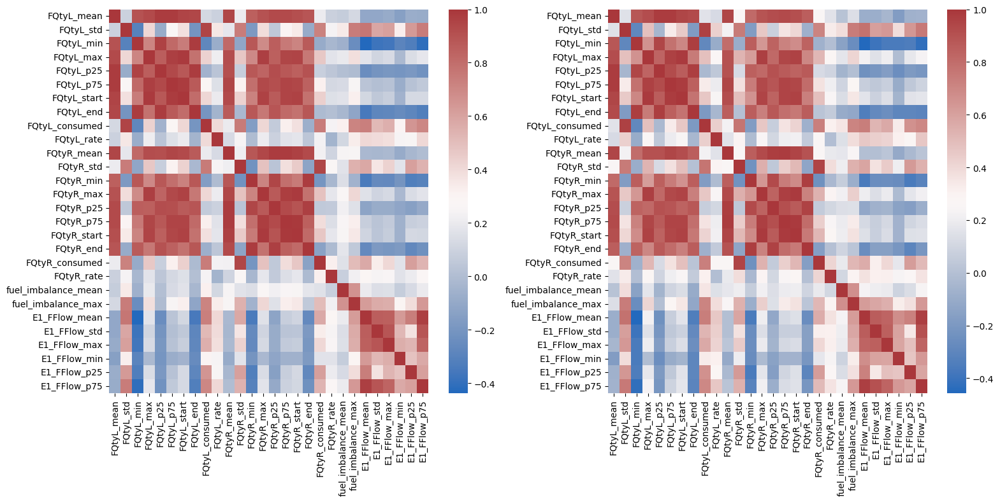

In [150]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, fuel_system_columns, width=8)

In [222]:
fuel_r2_df = get_r2_corr(pre_maintenance_df, fuel_system_columns)
fuel_r2_df.sort_values(by="r2", ascending=False).head()

,feature_1,feature_2,r2
57,FQtyL_max,FQtyR_max,0.949889
114,FQtyL_start,FQtyR_start,0.933121
60,FQtyL_max,FQtyR_start,0.932661
111,FQtyL_start,FQtyR_max,0.932156
113,FQtyL_start,FQtyR_p75,0.926243


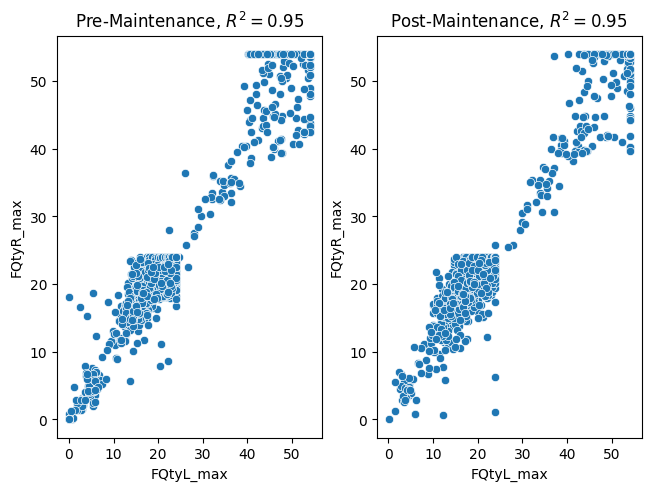

In [223]:
plot_two_features(pre_maintenance_df, post_maintenance_df, "FQtyL_max", "FQtyR_max")


#### Engine Performance Features

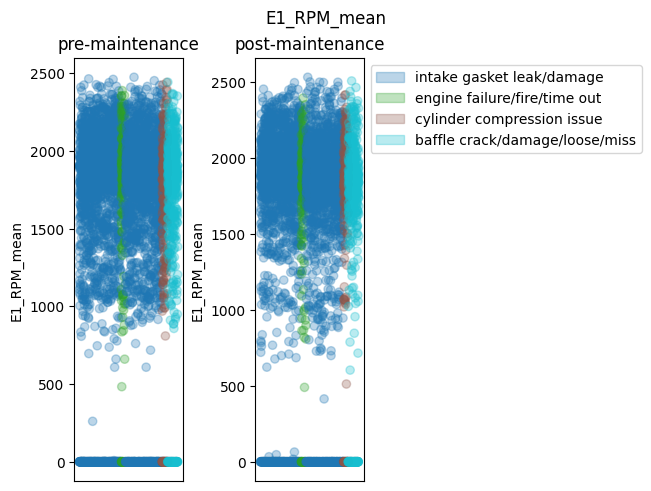

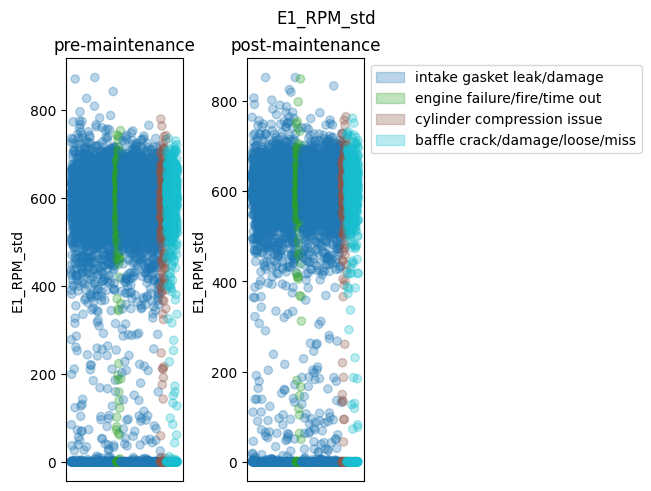

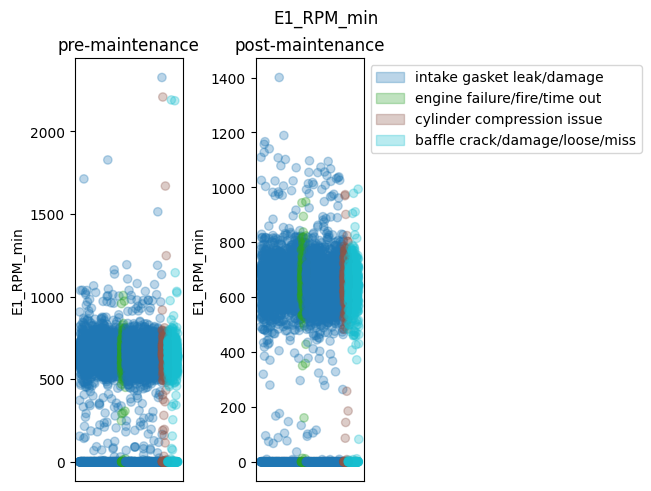

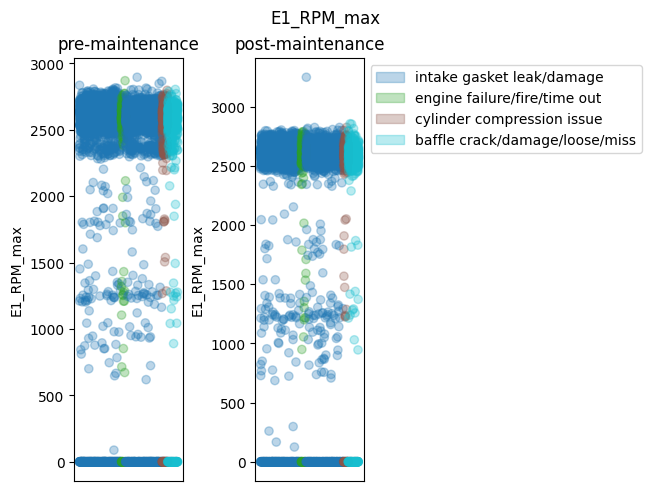

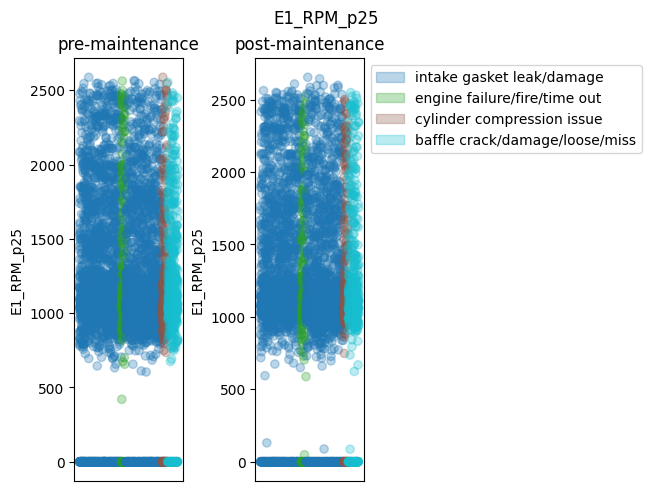

...

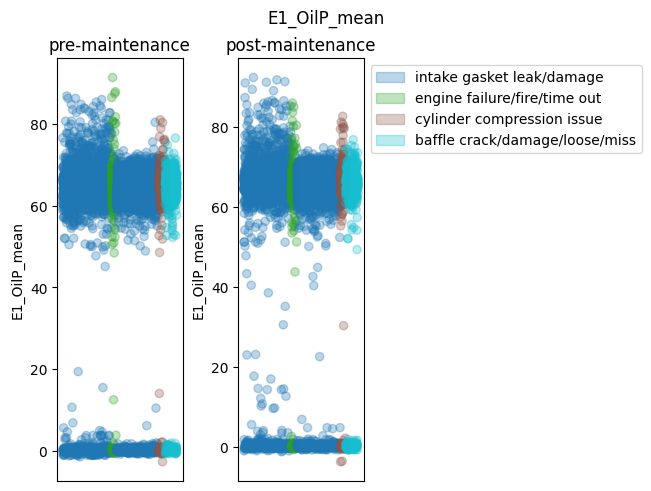

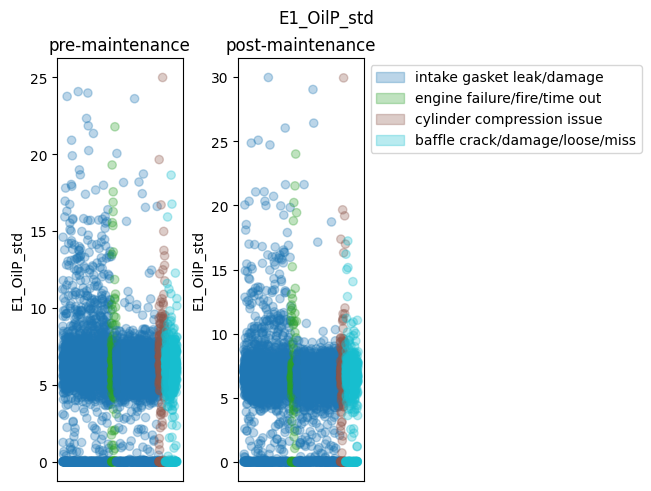

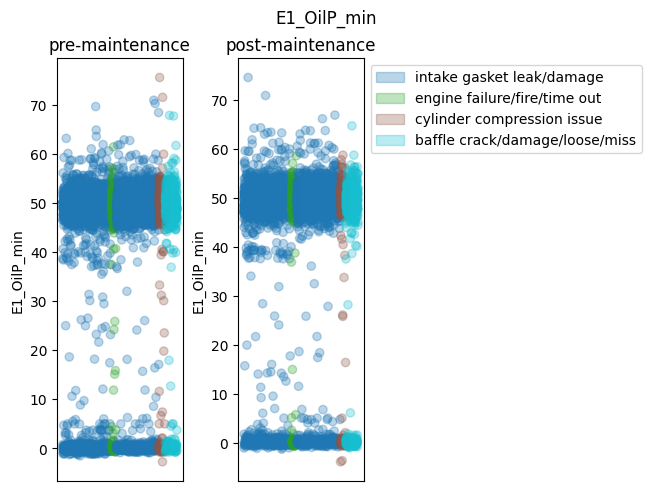

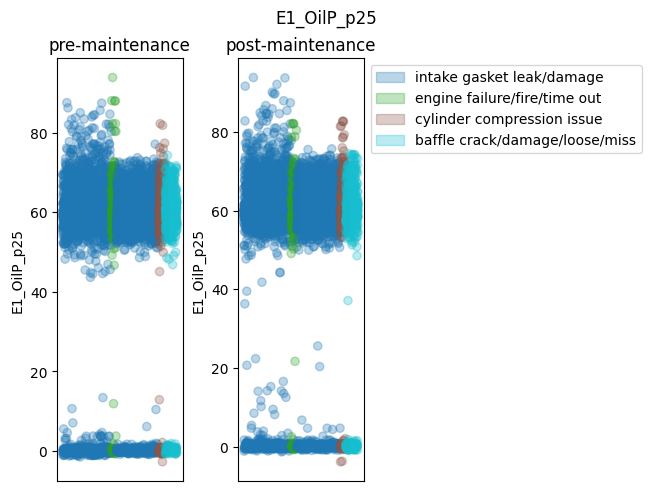

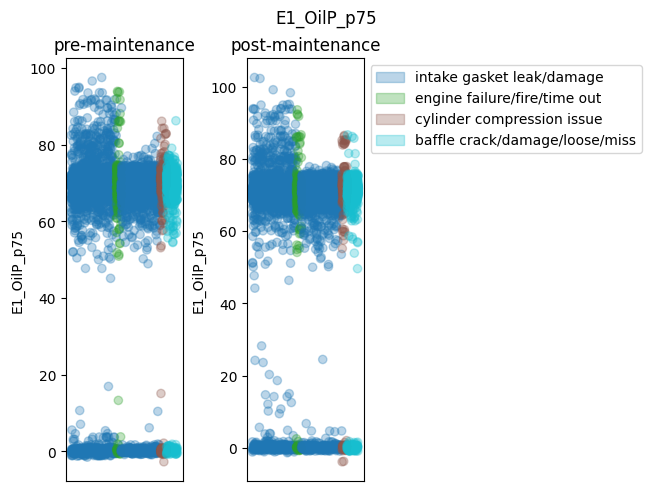

In [231]:
engine_perf_columns = get_engine_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, engine_perf_columns)

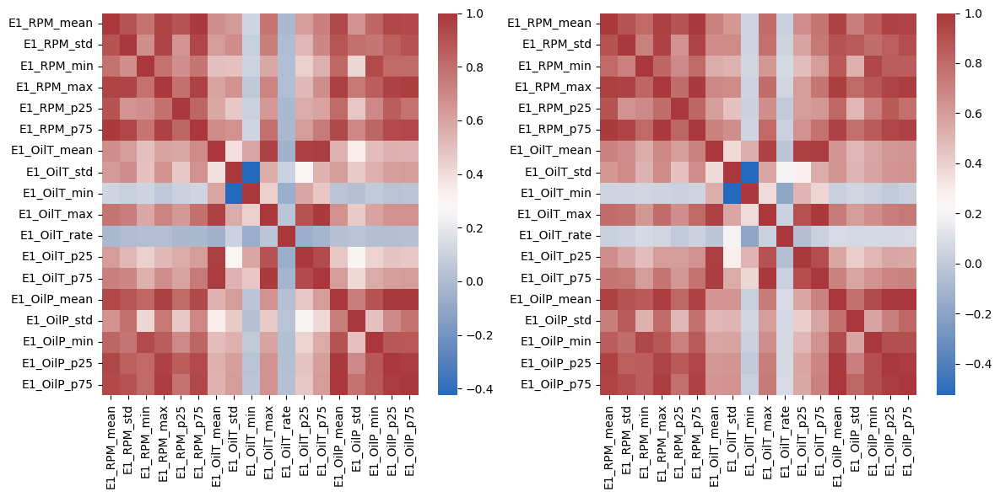

In [ ]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, engine_perf_columns, width=6)

In [235]:
engine_r2_df = get_r2_corr(pre_maintenance_df, engine_perf_columns)
engine_r2_df.sort_values(by="r2", ascending=False).head()

,feature_1,feature_2,r2
47,E1_RPM_max,E1_OilP_p75,0.954763
43,E1_RPM_max,E1_OilP_mean,0.950322
46,E1_RPM_max,E1_OilP_p25,0.922577
10,E1_RPM_mean,E1_OilP_p25,0.906429
7,E1_RPM_mean,E1_OilP_mean,0.897313


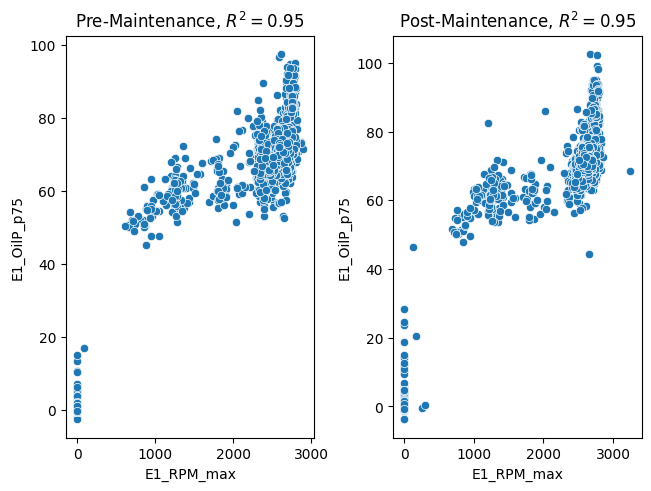

In [236]:
plot_two_features(pre_maintenance_df, post_maintenance_df, "E1_RPM_max", "E1_OilP_p75")

#### Cylinder Head Features

/tmp/ipykernel_72108/699101256.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2)


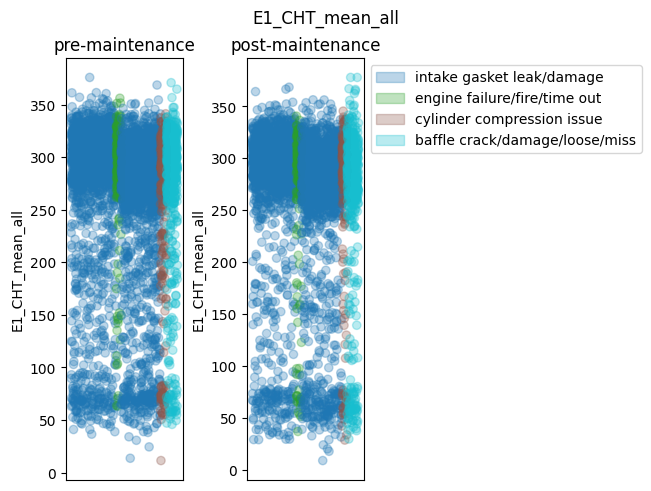

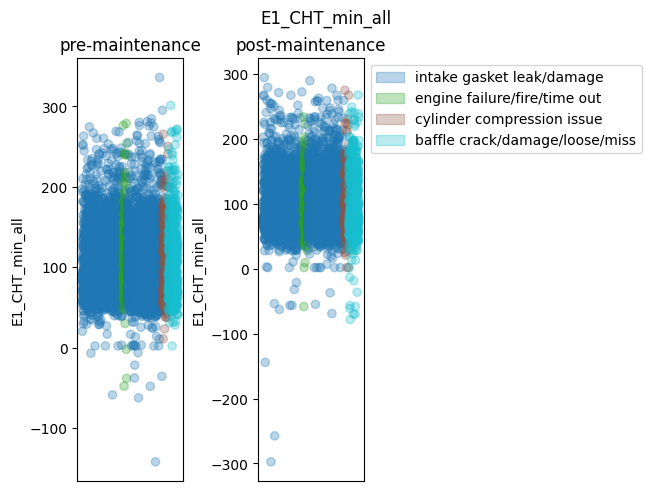

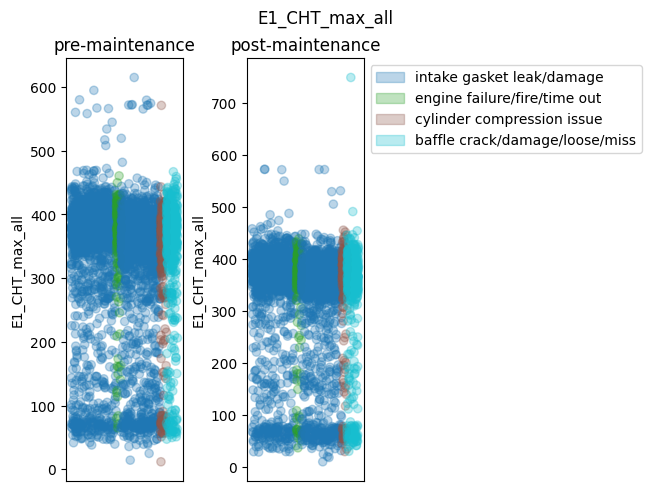

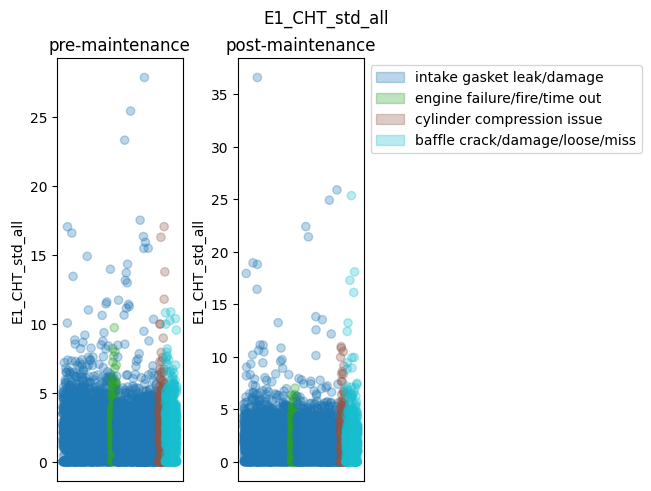

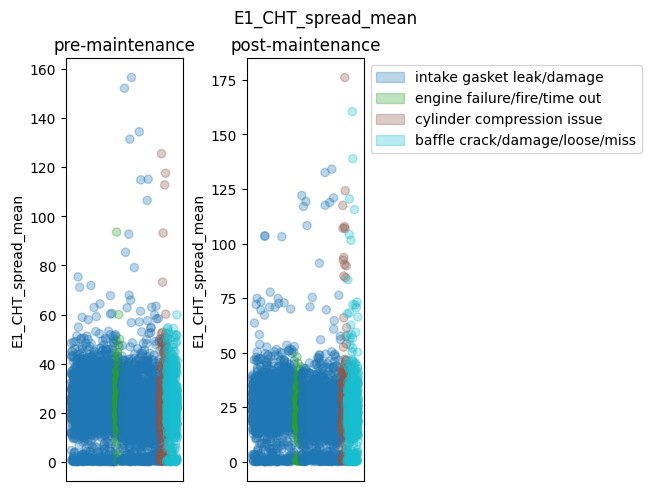

...

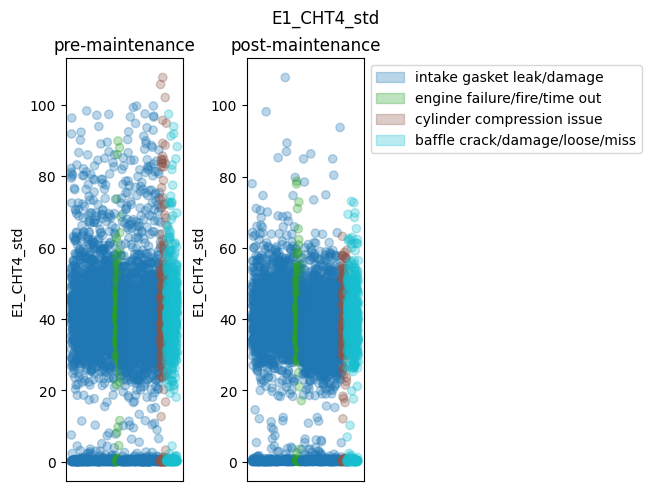

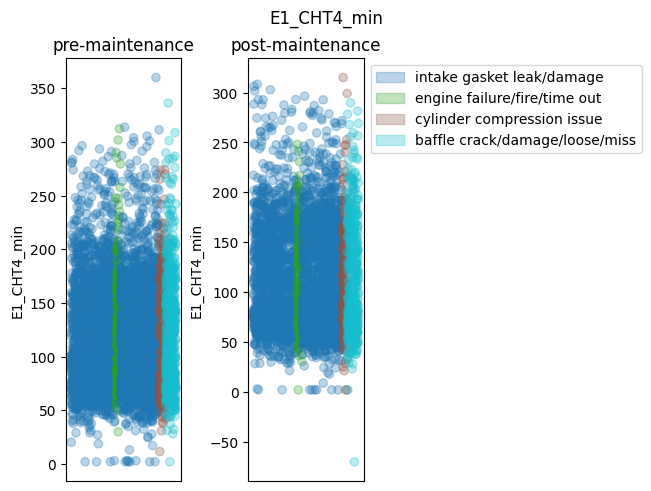

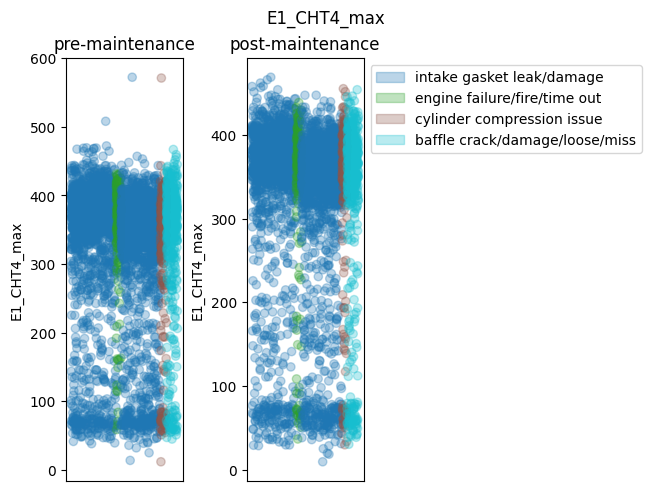

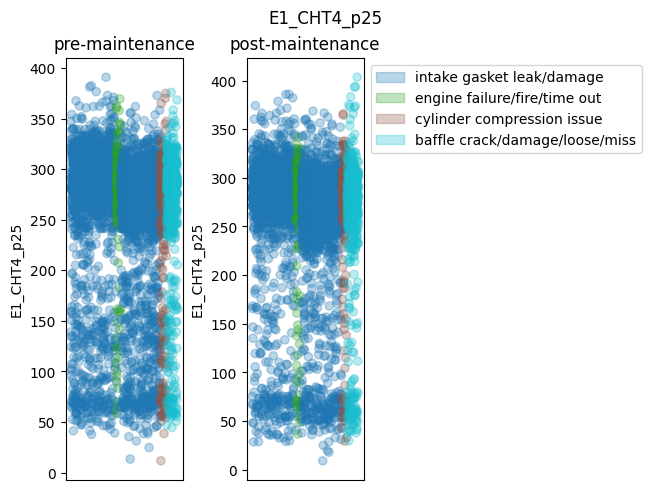

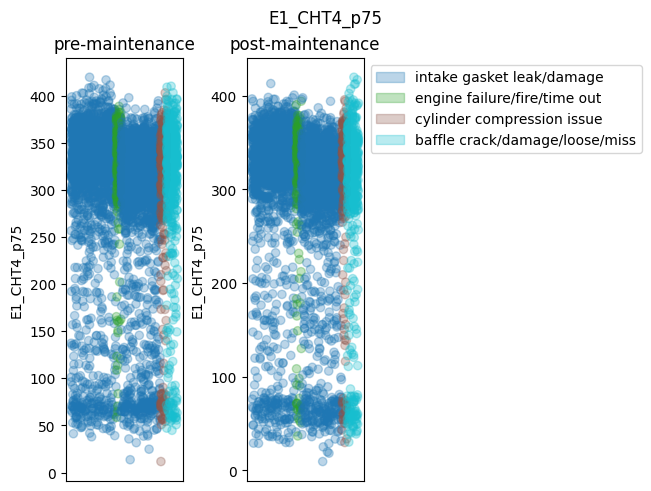

In [108]:
cylinder_head_columns = get_cylinder_head_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, cylinder_head_columns)

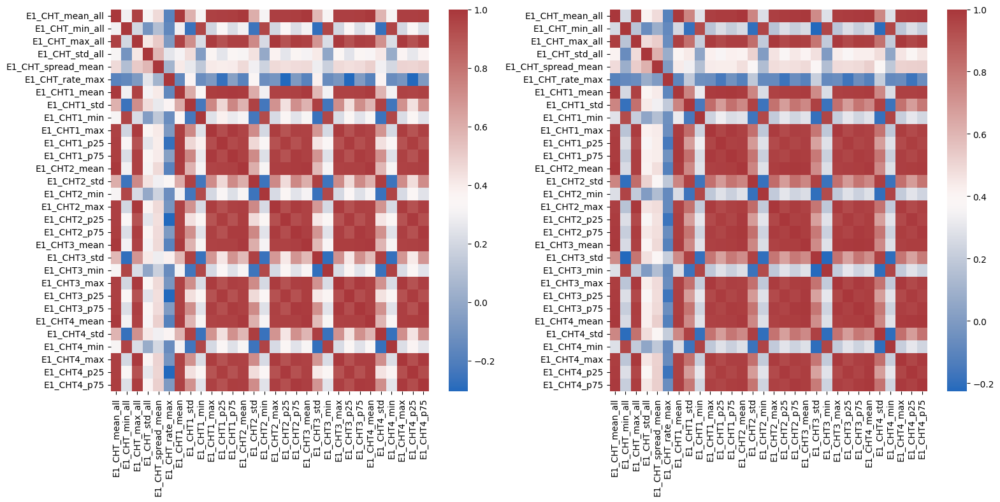

In [157]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, cylinder_head_columns, width=8)


In [237]:
ch_r2_df = get_r2_corr(pre_maintenance_df, cylinder_head_columns)
ch_r2_df.sort_values(by="r2", ascending=False).head()

,feature_1,feature_2,r2
11,E1_CHT_mean_all,E1_CHT2_mean,0.991654
17,E1_CHT_mean_all,E1_CHT3_mean,0.991340
5,E1_CHT_mean_all,E1_CHT1_mean,0.990098
23,E1_CHT_mean_all,E1_CHT4_mean,0.989041
69,E1_CHT_max_all,E1_CHT2_max,0.984483


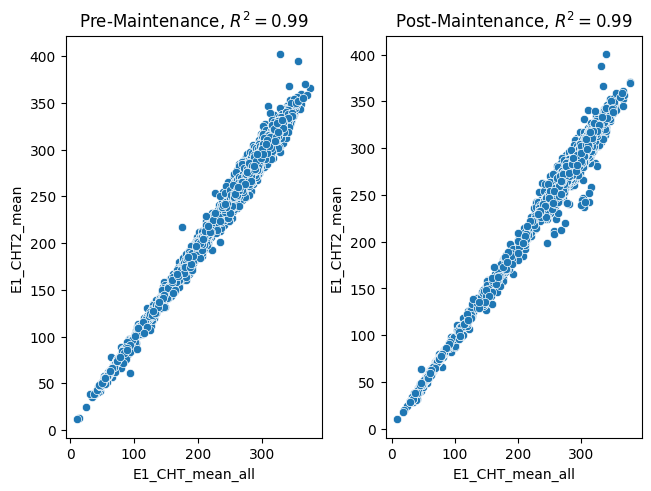

In [ ]:
plot_two_features(
    pre_maintenance_df, post_maintenance_df, "E1_CHT_mean_all", "E1_CHT2_mean"
)

#### Exhaust Gas Temperature Features

/tmp/ipykernel_72108/355777266.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2)


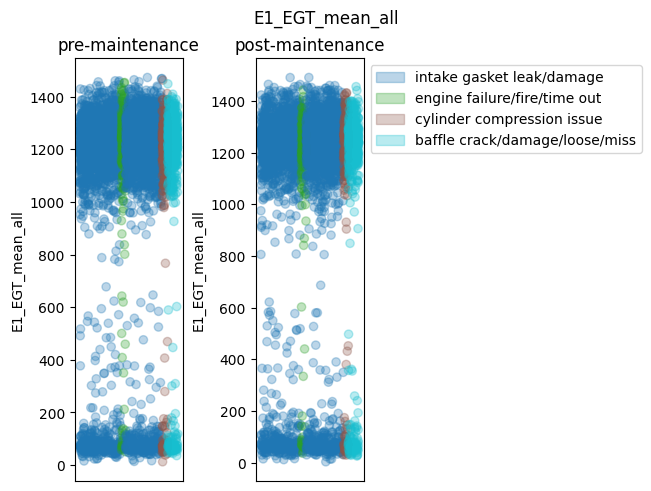

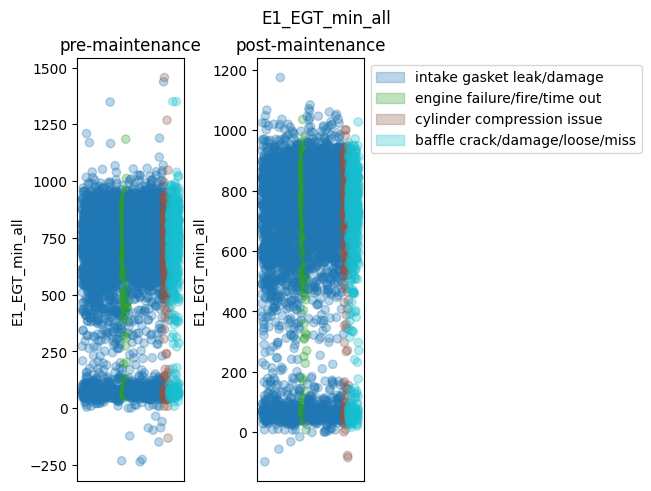

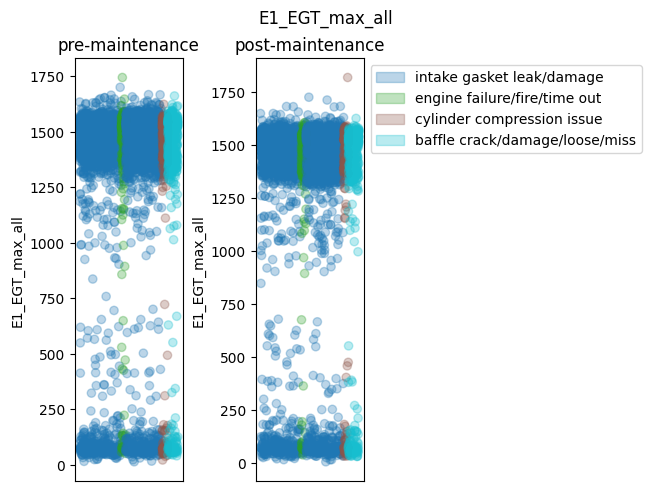

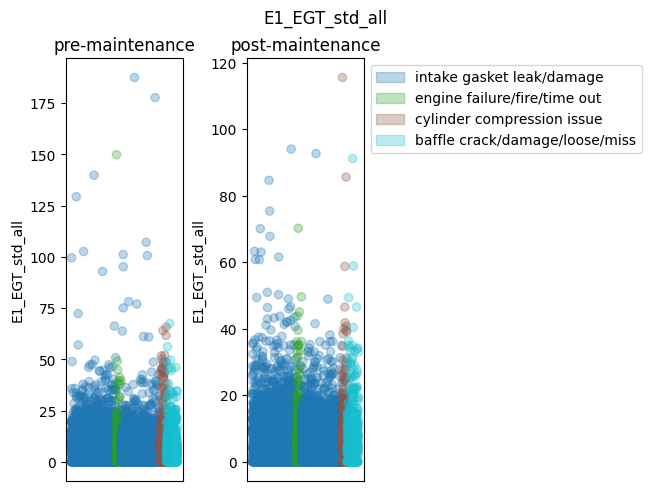

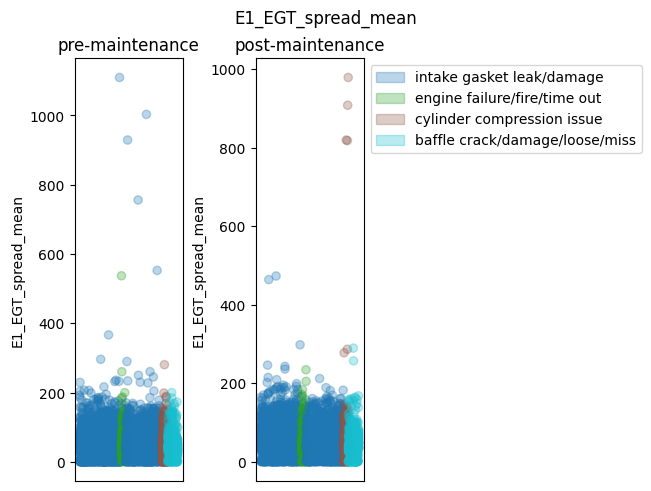

...

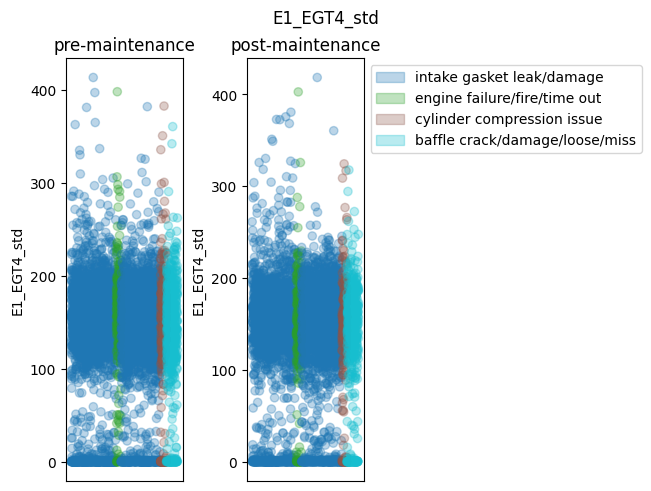

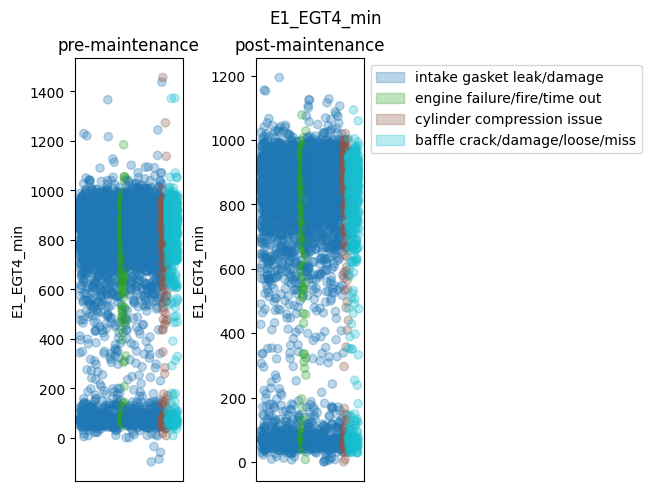

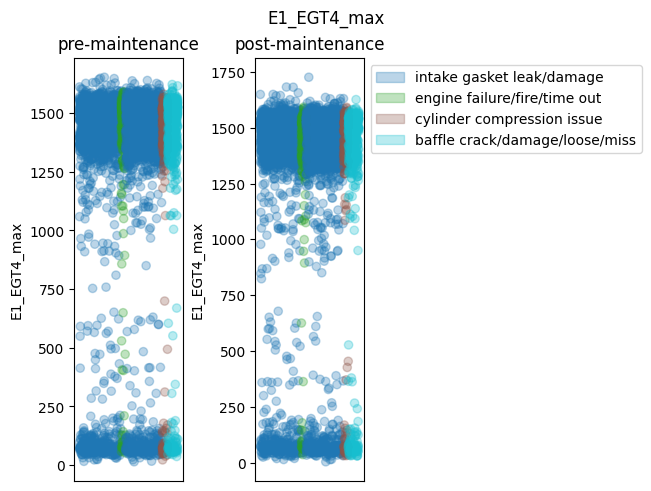

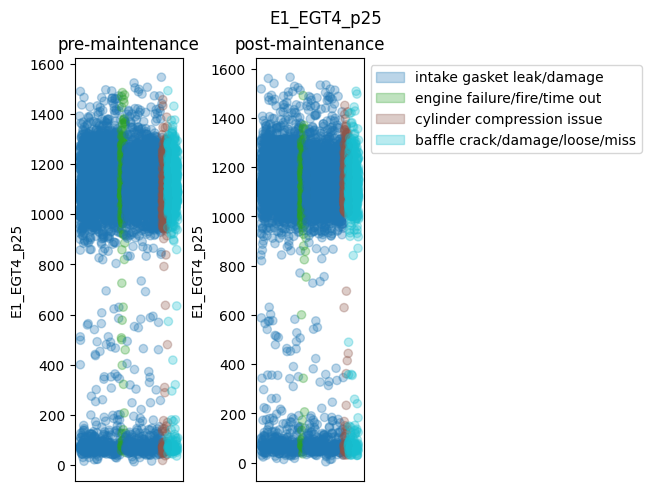

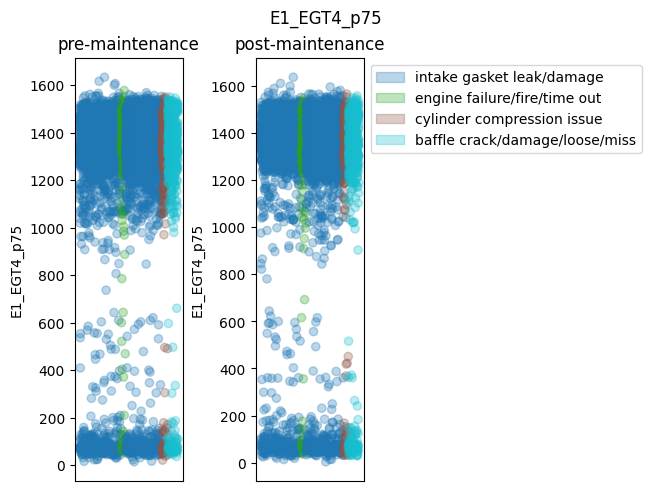

In [245]:
exhaust_gas_columns = get_exhaust_gas_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, exhaust_gas_columns)

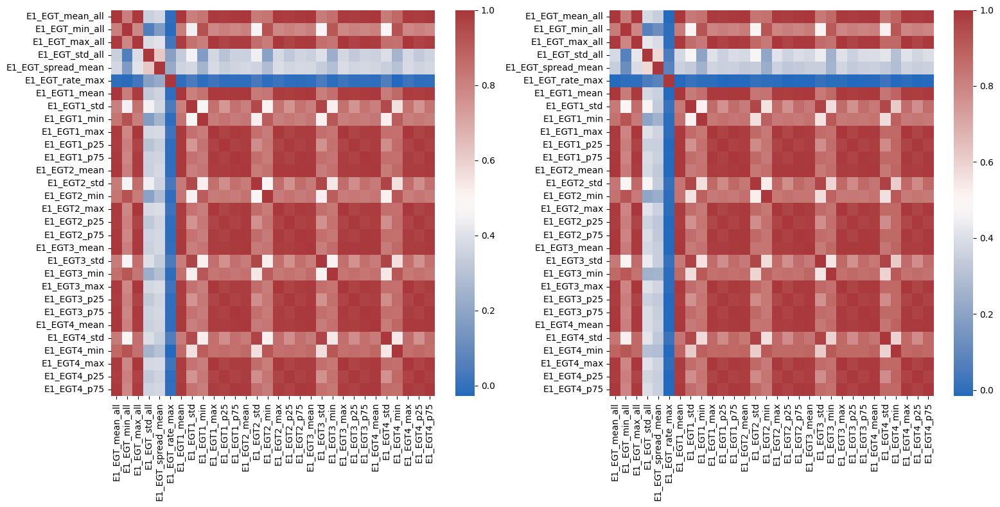

In [160]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, exhaust_gas_columns, width=8)

In [239]:
eg_r2_df = get_r2_corr(pre_maintenance_df, exhaust_gas_columns)
eg_r2_df.sort_values(by="r2", ascending=False).head()


,feature_1,feature_2,r2
23,E1_EGT_mean_all,E1_EGT4_mean,0.997492
81,E1_EGT_max_all,E1_EGT4_max,0.997066
17,E1_EGT_mean_all,E1_EGT3_mean,0.997011
69,E1_EGT_max_all,E1_EGT2_max,0.996884
11,E1_EGT_mean_all,E1_EGT2_mean,0.996460


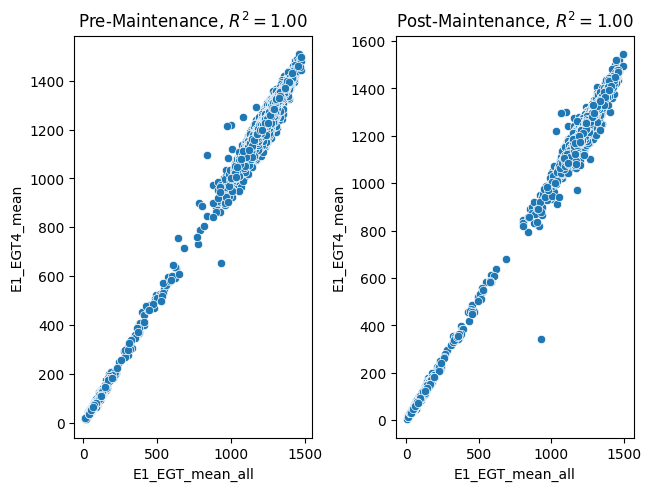

In [ ]:
plot_two_features(
    pre_maintenance_df, post_maintenance_df, "E1_EGT_mean_all", "E1_EGT4_mean"
)

#### Flight Dynamics Features

/tmp/ipykernel_72108/355777266.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 2)


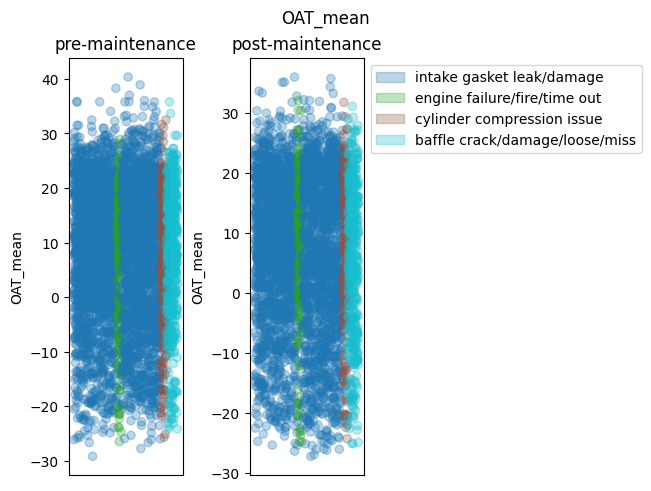

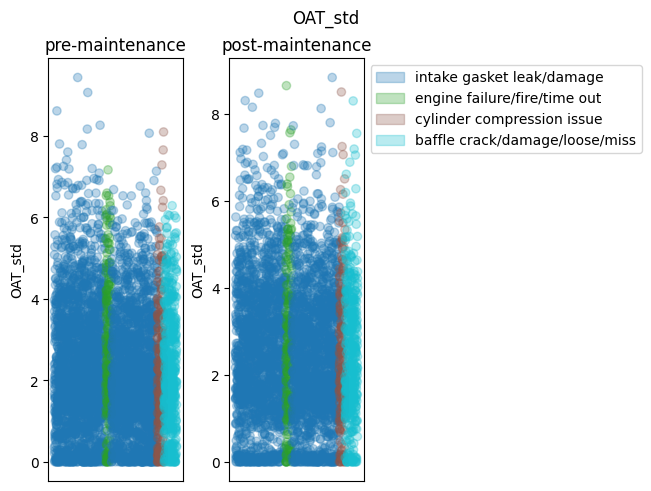

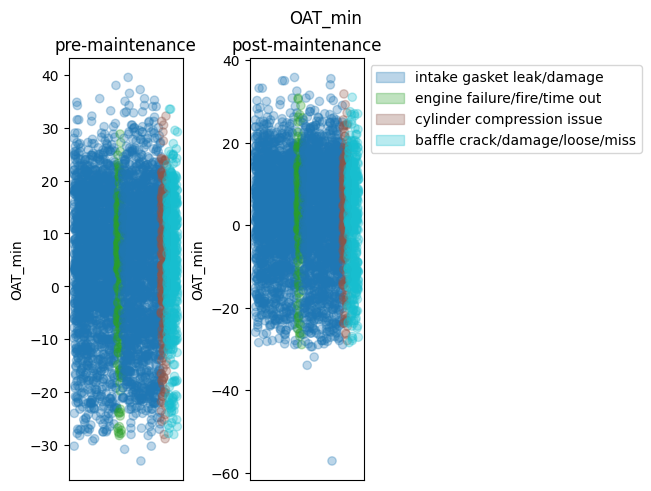

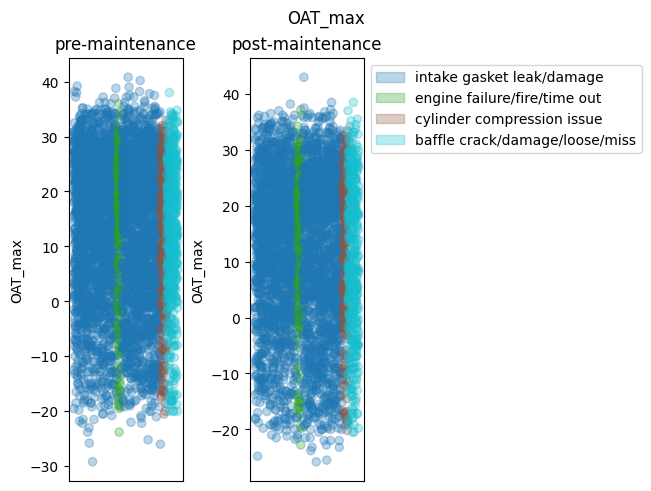

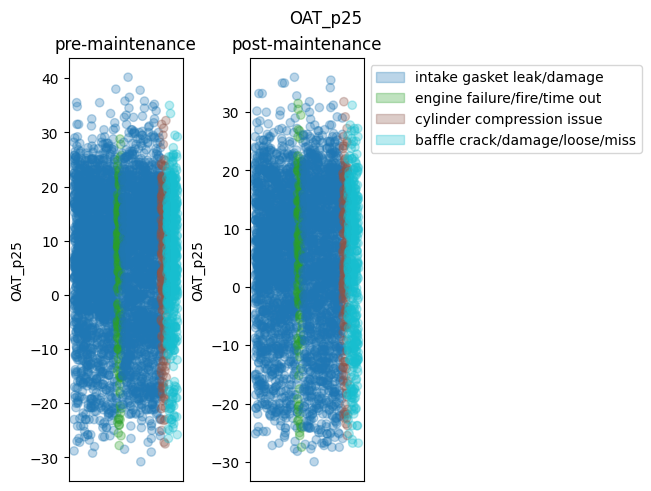

...

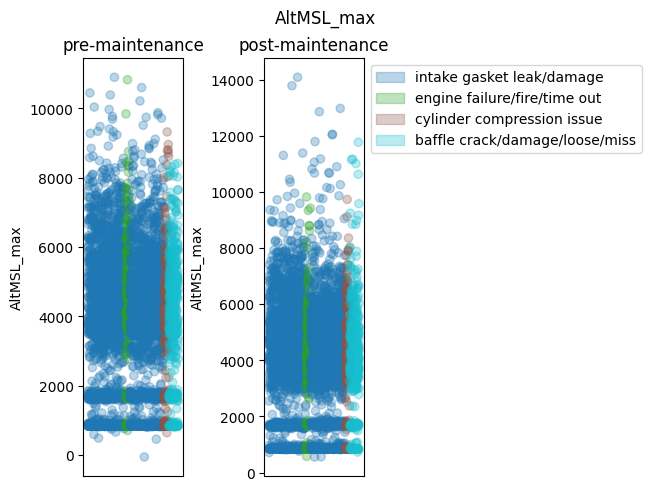

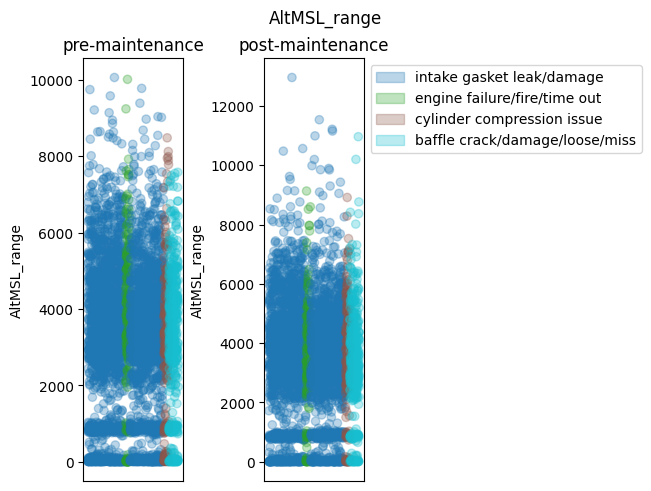

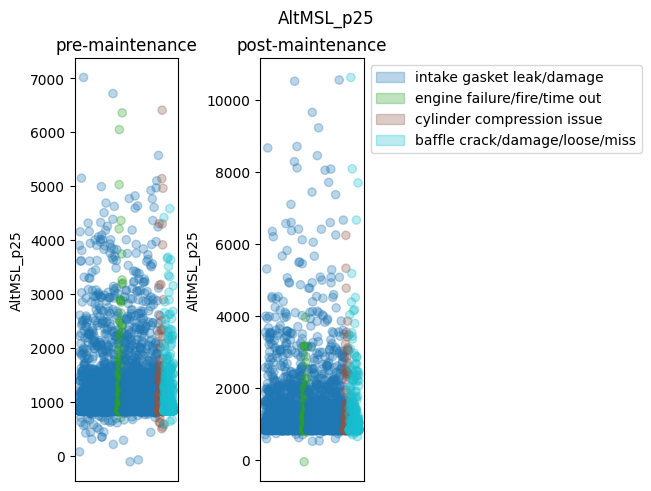

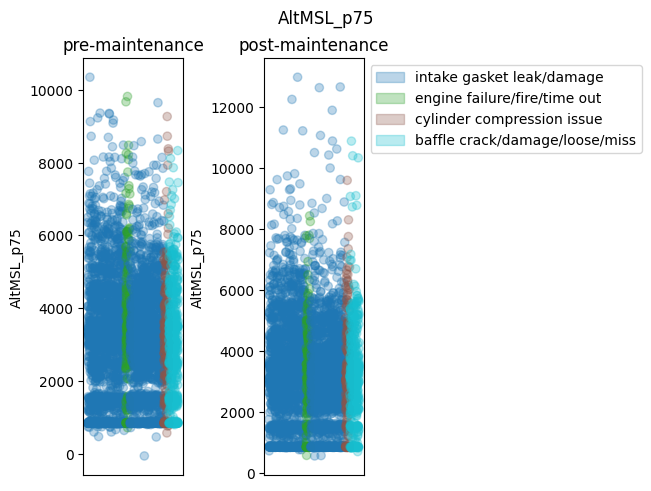

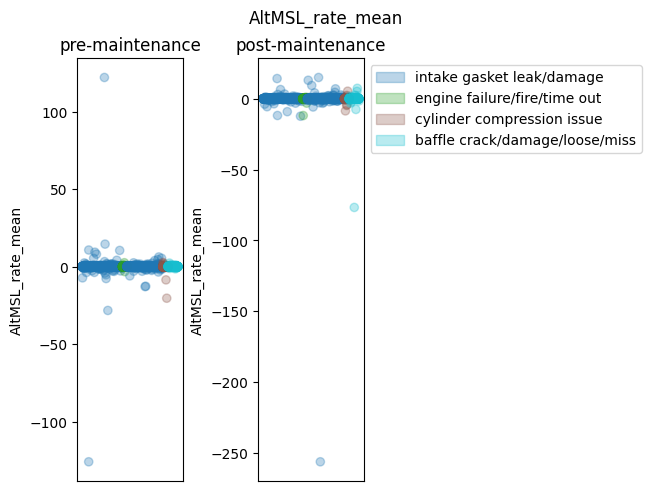

In [246]:
flight_dyn_columns = get_flight_dyn_features(flight_df).keys()
scatter_plot(pre_maintenance_df, post_maintenance_df, flight_dyn_columns)

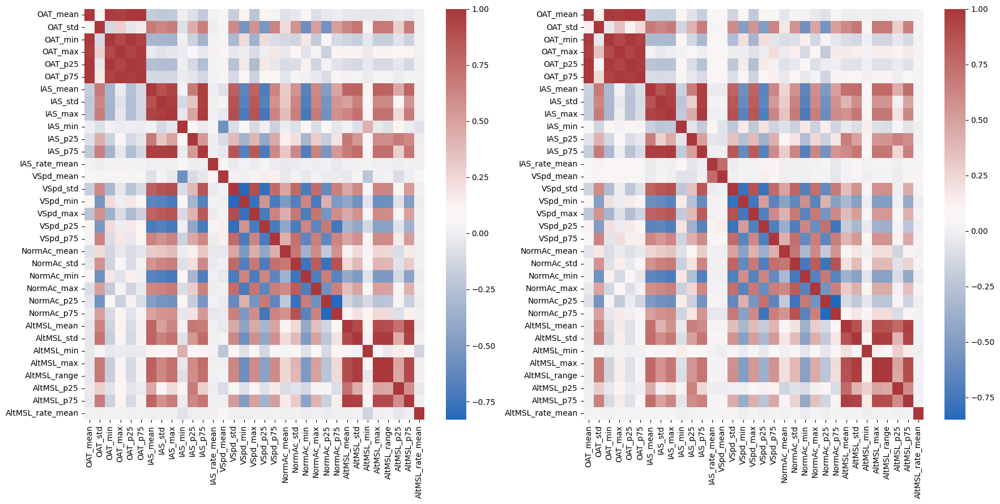

In [164]:
corr_heatmap(pre_maintenance_df, post_maintenance_df, flight_dyn_columns, width=9)

In [241]:
flight_r2_df = get_r2_corr(pre_maintenance_df, flight_dyn_columns)
flight_r2_df.sort_values(by="r2", ascending=False).head()

,feature_1,feature_2,r2
203,IAS_max,VSpd_std,0.755076
205,IAS_max,VSpd_max,0.704203
183,IAS_std,VSpd_std,0.699645
263,IAS_p75,VSpd_std,0.690421
177,IAS_mean,AltMSL_max,0.665598


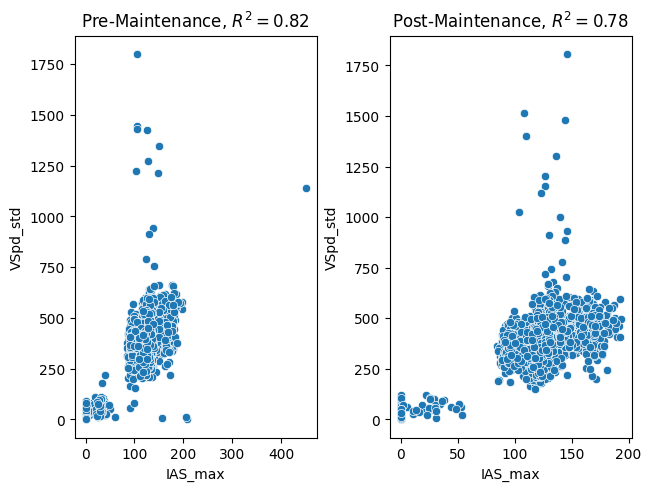

In [242]:
plot_two_features(pre_maintenance_df, post_maintenance_df, "IAS_max", "VSpd_std")

### Additional Features
- CHT and EGT spreads
- Cylinder imbalance
- Engine efficiency
- Amp1 and RPM

In [6]:
def get_cht_egt_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Returns CHT and EGT spreads"""
    egt1 = flight_df["E1 EGT1"].dropna()
    egt4 = flight_df["E1 EGT4"].dropna()
    cht1 = flight_df["E1 CHT1"].dropna()
    cht4 = flight_df["E1 CHT4"].dropna()
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()
    egt_all = flight_df[["E1 EGT1", "E1 EGT2", "E1 EGT3", "E1 EGT4"]].dropna()
    oat = flight_df["OAT"].dropna()

    return {
        # CHT/EGT relationships
        "E1_CHT_EGT_ratio_mean": np.nan
        if cht_all.empty or egt_all.empty
        else (cht_all.mean(axis=1) / egt_all.mean(axis=1)).mean(),
        "E1_CHT_EGT_ratio_std": np.nan
        if cht_all.empty or egt_all.empty
        else (cht_all.mean(axis=1) / egt_all.mean(axis=1)).std(),
        # Cylinder-specific ratios (cylinders 1 and 4)
        "E1_CHT1_EGT1_ratio_mean": np.nan
        if cht1.empty or egt1.empty
        else (cht1 / egt1).mean(),
        "E1_CHT4_EGT4_ratio_mean": np.nan
        if cht4.empty or egt4.empty
        else (cht4 / egt4).mean(),
        # Temperature efficiency: CHT relative to ambient
        "E1_CHT_OAT_diff_mean": np.nan
        if cht_all.empty or oat.empty
        else (cht_all.mean(axis=1) - oat).mean(),
        "E1_CHT_OAT_ratio_mean": np.nan
        if cht_all.empty or oat.empty
        else (cht_all.mean(axis=1) / oat.abs()).mean(),
    }

In [ ]:
# get_cht_egt_features(get_flight_df(ALL_FLIGHTS_DIR, 30))

In [ ]:
def get_cylinder_imbalance_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Cylinder-specific deviations and consistency metrics"""
    cht1 = flight_df["E1 CHT1"].dropna()
    cht4 = flight_df["E1 CHT4"].dropna()
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()

    egt4 = flight_df["E1 EGT4"].dropna()
    egt_all = flight_df[["E1 EGT1", "E1 EGT2", "E1 EGT3", "E1 EGT4"]].dropna()

    # Calculate overall means for deviation metrics
    cht_overall_mean = np.nan if cht_all.empty else cht_all.mean().mean()
    egt_overall_mean = np.nan if cht_all.empty else egt_all.mean().mean()

    return {
        # Coefficient of variation (normalized variability)
        "E1_CHT_cv": np.nan
        if np.isnan(cht_overall_mean)
        else cht_all.std().mean() / cht_overall_mean,
        "E1_EGT_cv": np.nan
        if np.isnan(cht_overall_mean)
        else egt_all.std().mean() / egt_overall_mean,
        # Identify problematic cylinders (deviation from group mean)
        "E1_CHT1_deviation": np.nan
        if cht1.empty or np.isnan(cht_overall_mean)
        else cht1.mean() - cht_overall_mean,
        "E1_CHT4_deviation": np.nan
        if cht4.empty or np.isnan(cht_overall_mean)
        else cht4.mean() - cht_overall_mean,
        "E1_EGT4_deviation": np.nan
        if egt4.empty or np.isnan(egt_overall_mean)
        else egt4.mean() - egt_overall_mean,
        # Range/IQR ratio (to detect outliers)
        "E1_CHT_range_iqr": (
            np.nan
            if cht_all.empty
            or np.isclose(
                (
                    denom := (
                        cht_all.quantile(0.75).mean() - cht_all.quantile(0.25).mean()
                    )
                ),
                0,
            )
            else (cht_all.max().max() - cht_all.min().min()) / denom
            # / (cht_all.quantile(0.75).mean() - cht_all.quantile(0.25).mean())
        ),
        "E1_EGT_range_iqr": (
            np.nan
            if egt_all.empty
            or np.isclose(
                denom := (
                    egt_all.quantile(0.75).mean() - egt_all.quantile(0.25).mean()
                ),
                0,
            )
            else (egt_all.max().max() - egt_all.min().min()) / denom
            # / (egt_all.quantile(0.75).mean() - egt_all.quantile(0.25).mean())
        ),
    }

In [ ]:
# get_cylinder_imbalance_features(get_flight_df(ALL_FLIGHTS_DIR, 30))

In [ ]:
def get_engine_efficiency_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Fuel efficiency and power loading indicators"""
    rpm = flight_df["E1 RPM"].dropna()
    rpm = rpm[rpm > 0]
    fflow = flight_df["E1 FFlow"].dropna()
    oil_press = flight_df["E1 OilP"].dropna()

    # fflow, rpm
    fflow_rpm_index = list(set(fflow.index) & set(rpm.index))

    return {
        # Specific fuel consumption (fuel per RPM)
        "E1_specific_fuel_consumption": np.nan
        if fflow.empty or rpm.empty or np.isclose(rpm.mean(), 0)
        else fflow.mean() / rpm.mean(),
        # Power loading indicator (RPM × fuel flow)
        "E1_power_metric": np.nan
        if fflow.empty or rpm.empty
        else (rpm[fflow_rpm_index] * fflow[fflow_rpm_index]).mean(),
        # Fuel efficiency variation
        "E1_FFlow_RPM_ratio_std": np.nan
        if fflow.empty or rpm.empty
        else (fflow[fflow_rpm_index] / rpm[fflow_rpm_index]).std(),
        # Oil pressure per RPM (may indicate mechanical health)
        "E1_OilP_RPM_ratio": np.nan
        if oil_press.empty or rpm.empty or np.isclose(rpm.mean(), 0)
        else oil_press.mean() / rpm.mean(),
    }

In [ ]:
# get_engine_efficiency_features(get_flight_df(ALL_FLIGHTS_DIR, 30))

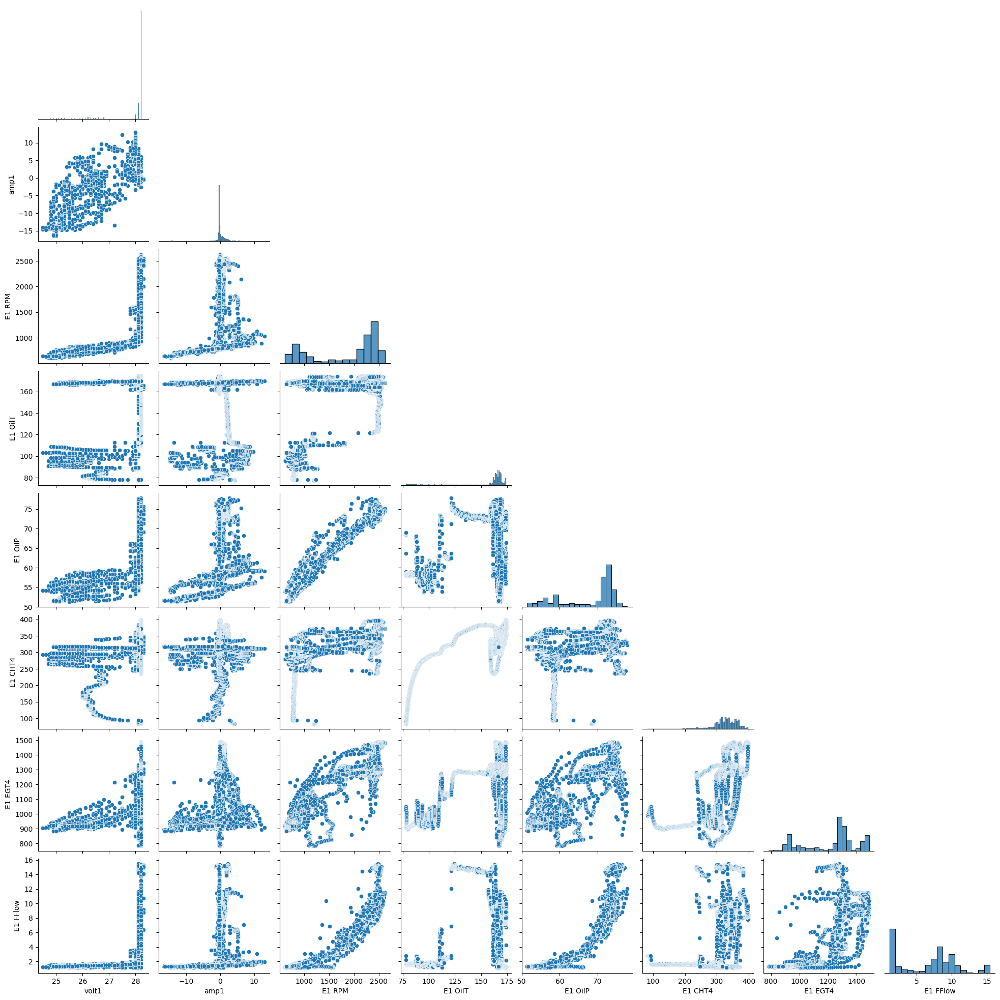

In [ ]:
# Pair plot for electrical system, engine system features
# flight_id = 32715
flight_id = 11997
flight_df = get_flight_df(ALL_FLIGHTS_DIR, flight_id)
features = [
    "volt1",
    # "volt2",
    "amp1",
    # "amp2",
    "E1 RPM",
    "E1 OilT",
    "E1 OilP",
    "E1 CHT4",
    "E1 EGT4",
    "E1 FFlow",
]

sns.pairplot(flight_df[features].dropna(), corner=True)

In [153]:
def get_electrical_stability_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Electrical system health and stability metrics"""
    flight_df = flight_df.reset_index()
    volt1 = flight_df["volt1"].dropna()
    amp1 = flight_df["amp1"].dropna()
    amp2 = flight_df["amp2"].dropna()
    rpm = flight_df["E1 RPM"].dropna()
    rpm = rpm[rpm > 0]

    # amp1, amp2 index
    amp1_amp2_index = list(set(amp1.index) & set(amp2.index))

    # volt1, rpm index
    volt1_rpm_index = list(set(rpm.index) & set(volt1.index))

    return {
        # Electrical load variability (may indicate alternator issues)
        "electrical_load_variance": np.nan
        if amp1.empty or amp2.empty
        else (amp1[amp1_amp2_index] + amp2[amp1_amp2_index]).std(),
        # Voltage stability under load
        "volt1_amp1_stability": np.nan
        if volt1.empty or amp1.empty
        else volt1.std() / (amp1.mean() + 1),  # mu + 1 is spread
        # Electrical-engine correlation
        "volt1_rpm_correlation": np.nan
        if volt1.empty
        or rpm.empty
        or len(volt1)
        or np.isclose(volt1.std(), 0)
        or np.isclose(rpm.std(), 0)
        or volt1.size == 1
        or rpm.size == 1
        else np.corrcoef(volt1[volt1_rpm_index], rpm[volt1_rpm_index])[0, 1],
        # Battery discharge events (negative current spikes)
        "amp1_negative_ratio": np.nan if amp1.empty else (amp1 < 0).sum() / len(amp1),
    }

In [292]:
# get_electrical_features(flight_df)

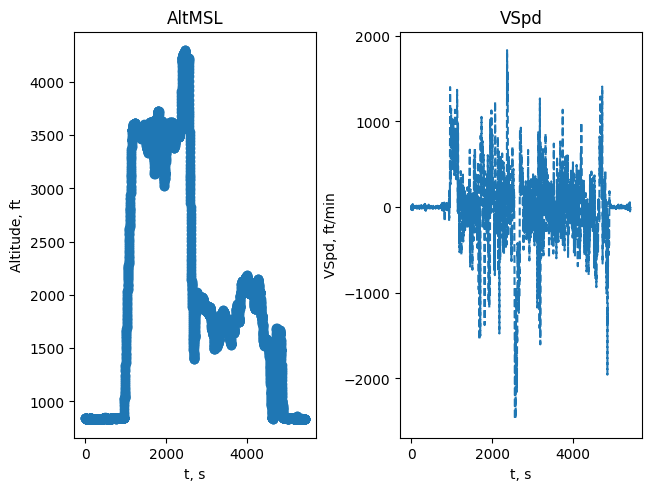

In [318]:
# Plot altitude

fig, axes = plt.subplots(1, 2)

ax = axes[0]
ax.plot(flight_df["timestep"], flight_df["AltMSL"], "o-")
ax.set_title("AltMSL")
ax.set_xlabel("t, s")
ax.set_ylabel("Altitude, ft")

ax = axes[1]
ax.plot(flight_df["timestep"], flight_df["VSpd"], "--")
ax.set_title("VSpd")
ax.set_xlabel("t, s")
ax.set_ylabel("VSpd, ft/min")

fig.set_layout_engine("constrained")

In [12]:
def get_climb_phase(flight_df: pd.DataFrame) -> pd.DataFrame:
    df = flight_df[["timestep", "VSpd", "AltMSL"]].dropna()
    if df.empty:
        return df

    # climb rate
    min_climb_rate = 400
    max_climb_rate = df["VSpd"].max()
    climb_phases = df[
        (df["VSpd"] >= min_climb_rate) & (df["VSpd"] <= max_climb_rate)
    ].copy()

    # Split into groups
    breaks = climb_phases["timestep"].diff() > 1
    climb_phases["phase"] = np.cumsum(breaks)

    return climb_phases


In [13]:
def get_descend_phase(flight_df: pd.DataFrame) -> pd.DataFrame:
    df = flight_df[["timestep", "VSpd", "AltMSL"]].dropna()
    if df.empty:
        return df

    # climb rate
    min_rate = -200
    phases = df[(df["VSpd"] <= min_rate)].copy()

    # Split into groups
    breaks = phases["timestep"].diff() > 1
    phases["phase"] = np.cumsum(breaks)

    return phases

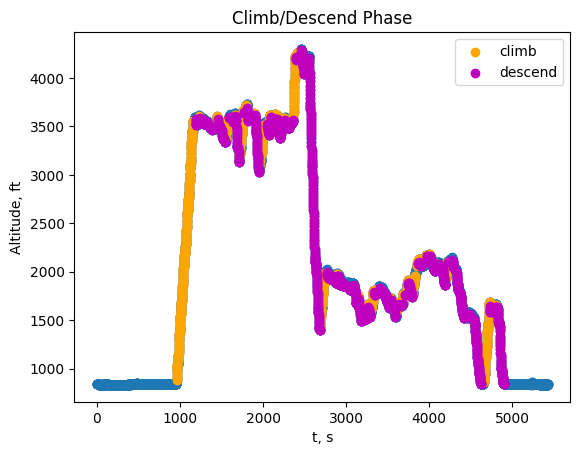

In [442]:
# Climb
climb_phases = get_climb_phase(flight_df)
# climb_phase = climb_phases["phase"].value_counts().idxmax()
# longest_climb = climb_phases[climb_phases["phase"] == climb_phase]

# Descend
descend_phases = get_descend_phase(flight_df)
# descend_phase = descend_phases["phase"].value_counts().idxmax()
# longest_descend = descend_phases[descend_phases["phase"] == descend_phase]

plt.scatter(flight_df["timestep"], flight_df["AltMSL"])
# plt.scatter(longest_climb["timestep"], longest_climb["AltMSL"], c="orange", label="climb")
plt.scatter(climb_phases["timestep"], climb_phases["AltMSL"], c="orange", label="climb")
# plt.scatter(longest_descend["timestep"], longest_descend["AltMSL"], c="m", label="descend")
plt.scatter(
    descend_phases["timestep"], descend_phases["AltMSL"], c="m", label="descend"
)
plt.title("Climb/Descend Phase")
plt.xlabel("t, s")
plt.ylabel("Altitude, ft")
plt.legend()


In [ ]:
def get_temporal_dynamics_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Rate of change and thermal metrics"""
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()
    egt_all = flight_df[["E1 EGT1", "E1 EGT2", "E1 EGT3", "E1 EGT4"]].dropna()
    fflow = flight_df["E1 FFlow"].dropna()
    oil_press = flight_df["E1 OilP"].dropna()
    oil_temp = flight_df["E1 OilT"].dropna()
    # alt = flight_df["AltMSL"].dropna()

    # Get climb/descend phases
    climb_phases = get_climb_phase(flight_df)
    descend_phases = get_descend_phase(flight_df)
    if climb_phases.empty or descend_phases.empty:
        climb_mask = None
        descend_mask = None
    else:
        flight_df = flight_df[["timestep", "E1 OilT"]].dropna()

        # climb
        climb_mask = flight_df["timestep"].isin(climb_phases["timestep"])

        # descend
        descend_mask = flight_df["timestep"].isin(descend_phases["timestep"])

    return {
        # Temperature metrics (rapid changes)
        "E1_CHT_max_rate_change": np.nan
        if cht_all.empty
        else cht_all.diff().abs().max().max(),
        "E1_CHT_acceleration": np.nan
        if cht_all.empty
        else cht_all.diff().diff().std().mean(),
        "E1_EGT_max_rate_change": np.nan
        if egt_all.empty
        else egt_all.diff().abs().max().max(),
        # Acceleration metrics (not just mean rate)
        "E1_FFlow_acceleration": np.nan if fflow.empty else fflow.diff().diff().std(),
        # Oil pressure instability (rapid fluctuations indicate problems)
        "E1_OilP_instability": np.nan
        if oil_press.empty
        else oil_press.diff().abs().mean(),
        "E1_OilT_climb_rate": np.nan
        if oil_temp.empty or climb_mask is None
        else oil_temp[climb_mask].mean() / len(climb_mask),
        "E1_OilT_descend_rate": np.nan
        if oil_temp.empty or descend_mask is None
        else oil_temp[descend_mask].mean() / len(descend_mask),
    }

In [15]:
# get_temporal_dynamics_features(flight_df)

In [16]:
def get_cruise_phase(df: pd.DataFrame) -> pd.DataFrame:
    df = df[["timestep", "AltMSL", "VSpd"]].dropna()
    if df.empty:
        return df

    vspd_threshold = 100  # vertical speed delta while cruising

    # filter
    alt_mask = df["AltMSL"] > 0.25 * df["AltMSL"].max()
    vspd_mask = (df["VSpd"] > -vspd_threshold) & (
        df["VSpd"] < vspd_threshold
    )  # Vertical Speed Mask
    df = df[alt_mask & vspd_mask].copy()

    # Phase
    breaks = df["timestep"].diff() > 60
    df["phase"] = np.cumsum(breaks)

    return df

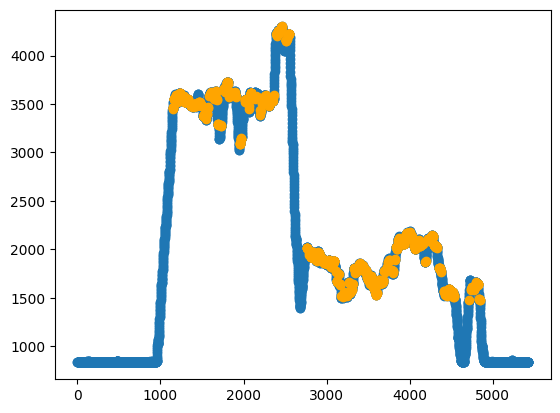

In [453]:
phases = get_cruise_phase(flight_df)
phase = phases["phase"].value_counts().idxmax()
longest_phase = phases[phases["phase"] == phase]

# phases["phase"].value_counts()

plt.scatter(flight_df["timestep"], flight_df["AltMSL"])
# plt.scatter(longest_phase["timestep"], longest_phase["AltMSL"], c="orange", label="climb")
plt.scatter(phases["timestep"], phases["AltMSL"], c="orange")
# plt.title("Climb/Descend Phase")
# plt.xlabel("t, s")
# plt.ylabel("Altitude, ft");
# plt.legend()


In [62]:
def get_operating_regime_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Flight phase characteristics and stress indicators"""
    # Thresholds
    cht_max = 435  # F
    oil_max = 240  # F

    rpm = flight_df["E1 RPM"].dropna()
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()
    oil_temp = flight_df["E1 OilT"].dropna()

    # Get cruise phases
    phases = get_cruise_phase(flight_df)
    rpm_df = flight_df[["timestep", "E1 RPM"]].dropna()
    rpm_mask = rpm_df["timestep"].isin(phases["timestep"])

    cht_df = flight_df[
        ["timestep", "E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]
    ].dropna()
    cht_mask = cht_df["timestep"].isin(phases["timestep"])

    return {
        # High power operation time (likely takeoff/climb)
        "high_power_duration_ratio": np.nan
        if rpm.empty
        else ((rpm > rpm.quantile(0.75)).sum() / len(rpm)),
        "high_temp_duration_ratio": np.nan
        if cht_all.empty
        else (
            (cht_all.max(axis=1) > cht_all.max(axis=1).quantile(0.75)).sum()
            / len(cht_all)
        ),
        # Time in red-line regions (overheating) - adjust thresholds as needed
        "E1_CHT_threshold": np.nan
        if cht_all.empty
        else ((cht_all.max(axis=1) > cht_max).sum() / len(cht_all)),
        "E1_OilT_threshold": np.nan
        if oil_temp.empty
        else ((oil_temp > oil_max).sum() / len(oil_temp)),
        # Cruise stability (low std during mid-flight indicates good health)
        "E1_CHT_cruise_stability": np.nan
        if cht_all.empty or cht_mask.empty
        else cht_all[cht_mask].std().mean(),
        "E1_RPM_cruise_stability": np.nan
        if rpm.empty or rpm_mask.empty
        else rpm[rpm_mask].std(),
    }

In [18]:
# get_operating_regime_features(flight_df)

In [154]:
def get_anomaly_indicator_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """Detect unusual parameter relationships"""
    flight_df = flight_df.reset_index()
    rpm = flight_df["E1 RPM"].dropna()
    rpm = rpm[rpm > 0.0]
    oil_press = flight_df["E1 OilP"].dropna()
    cht2 = flight_df["E1 CHT2"].dropna()
    cht4 = flight_df["E1 CHT4"].dropna()
    egt1 = flight_df["E1 EGT4"].dropna()
    egt3 = flight_df["E1 EGT3"].dropna()
    fqtyl = flight_df["FQtyL"].dropna()
    fqtyr = flight_df["FQtyR"].dropna()

    # oil, rpm index
    oil_rpm_index = list(set(oil_press.index) & set(rpm.index))

    # cht index
    cht_index = list(set(cht2.index) & set(cht4.index))

    # egt index
    egt_index = list(set(egt1.index) & set(egt3.index))

    return {
        # correlation observed between oilp and rpm - maybe deviation indicates issues
        "E1_OilP_RPM_corr": np.nan
        if oil_press.empty
        or rpm.empty
        or np.isclose(oil_press.std(), 0)
        or np.isclose(rpm.std(), 0)
        or rpm.size == 1
        or oil_press.size == 1
        else np.corrcoef(oil_press[oil_rpm_index], rpm[oil_rpm_index])[0, 1],
        # cht corr - maybe poor corr indicates issue
        "E1_CHT2_CHT4_corr": np.nan
        if cht2.empty
        or cht4.empty
        or np.isclose(cht2.std(), 0)
        or np.isclose(cht4.std(), 0)
        or cht2.size == 1
        or cht4.size == 1
        else np.corrcoef(cht2[cht_index], cht4[cht_index])[0, 1],
        # egt corr
        "E1_EGT1_EGT3_corr": np.nan
        if egt1.empty
        or egt3.empty
        or np.isclose(egt1.std(), 0)
        or np.isclose(egt3.std(), 0)
        or egt1.size == 1
        or egt3.size == 1
        else np.corrcoef(egt1[egt_index], egt3[egt_index])[0, 1],
        # Fuel imbalance rate (worsening imbalance during flight)
        "fuel_imbalance_trend": np.nan
        if fqtyl.empty or fqtyr.empty
        else (fqtyl - fqtyr).abs().diff().dropna().mean(),
    }

In [20]:
# get_anomaly_indicator_features(flight_df)

In [ ]:
def get_percentile_extreme_features(flight_df: pd.DataFrame) -> dict[str, float]:
    """extreme value metrics using percentiles"""
    cht_all = flight_df[["E1 CHT1", "E1 CHT2", "E1 CHT3", "E1 CHT4"]].dropna()
    egt_all = flight_df[["E1 EGT1", "E1 EGT2", "E1 EGT3", "E1 EGT4"]].dropna()

    return {
        # 90th/10th percentile spreads (more robust than max/min)
        "E1_CHT_p90_p10_spread": np.nan
        if cht_all.empty
        else (cht_all.quantile(0.9).mean() - cht_all.quantile(0.1).mean()),
        "E1_EGT_p90_p10_spread": np.nan
        if egt_all.empty
        else (egt_all.quantile(0.9).mean() - egt_all.quantile(0.1).mean()),
        # Asymmetry in distributions (skewness via percentiles)
        "E1_CHT_asymmetry": np.nan
        if cht_all.empty
        or np.isclose(
            (denom := (cht_all.quantile(0.5).mean() - cht_all.quantile(0.25).mean())), 0
        )
        else ((cht_all.quantile(0.75).mean() - cht_all.quantile(0.5).mean()) / denom),
        # Upper percentile of spreads (worst-case scenarios)
        "E1_CHT_spread_p90": np.nan
        if cht_all.empty
        else (cht_all.max(axis=1) - cht_all.min(axis=1)).quantile(0.9),
    }

In [22]:
# get_percentile_extreme_features(flight_df)

In [ ]:
# Define path for addtl_stats
addtl_stats_path = PROJECT_DIR / "data" / "addtl_stats.parquet"

In [ ]:
# ### Run with cuation - takes hours! ###

# addtl_features = []
# for flight_id in flight_ids:
#     flight_df = get_flight_df(ALL_FLIGHTS_DIR, flight_id)
#     addtl_features.append(
#         {
#             "flight_id": flight_id,
#             **get_cht_egt_features(flight_df),
#             **get_cylinder_imbalance_features(flight_df),
#             **get_engine_efficiency_features(flight_df),
#             **get_electrical_stability_features(flight_df),
#             **get_temporal_dynamics_features(flight_df),
#             **get_operating_regime_features(flight_df),
#             **get_anomaly_indicator_features(flight_df),
#             **get_percentile_extreme_features(flight_df),
#         }
#     )

# # to df
# addtl_stats_df = pd.DataFrame(addtl_features)
# addtl_stats_df.to_parquet(addtl_stats_path)

In [ ]:
# open addtl_stats
addtl_stats_df = pd.read_parquet(addtl_stats_path)
addtl_stats_df.head()

,E1_CHT_EGT_ratio_mean,E1_CHT_EGT_ratio_std,E1_CHT1_EGT1_ratio_mean,E1_CHT4_EGT4_ratio_mean,E1_CHT_OAT_diff_mean,E1_CHT_OAT_ratio_mean,E1_CHT_cv,E1_EGT_cv,E1_CHT1_deviation,E1_CHT4_deviation,...,E1_CHT_cruise_stability,E1_RPM_cruise_stability,E1_OilP_RPM_corr,E1_CHT2_CHT4_corr,E1_EGT1_EGT3_corr,fuel_imbalance_trend,E1_CHT_p90_p10_spread,E1_EGT_p90_p10_spread,E1_CHT_asymmetry,E1_CHT_spread_p90
0,NaN,NaN,0.289607,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,135.360540,0.928213,NaN,0.991630,0.000837,NaN,442.29050,NaN,NaN
1,0.233096,0.035603,0.240109,0.216159,259.444311,13.812147,0.158062,0.139468,6.859669,-15.448587,...,20.371883,222.531540,0.973778,0.921516,0.996713,0.000105,97.8160,508.72900,0.639139,40.692
2,NaN,NaN,0.988797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,0.981069,-0.002973,NaN,0.12425,NaN,NaN
3,0.996343,0.000273,0.984173,1.008074,59.390385,2.966569,0.001326,0.001080,-5.356538,6.541923,...,NaN,NaN,NaN,0.982345,0.961690,NaN,0.2940,0.23050,0.163636,11.910
4,0.257233,0.077475,0.258959,0.255352,242.435359,9.135134,0.275134,0.137465,-2.759034,-1.922650,...,73.223720,451.412721,0.941312,0.997425,0.998258,-0.000924,195.6855,419.10500,0.903723,11.694


In [160]:
# merge with all_stats
all_stats_path = PROJECT_DIR / "data" / "all_stats.parquet"

all_stats_df = pd.read_parquet(all_stats_path)
all_stats_df.shape

(28935, 169)

In [ ]:
(all_stats_df.index == addtl_stats_df.index).all()  # forgot to add fligth_id column!

np.True_

In [174]:
combined_stats_df = pd.merge(all_stats_df, addtl_stats_df, left_index=True, right_index=True)

In [175]:
combined_stats_df.head()

,flight_id,before_after,date_diff,flight_length,label,num_flights_before,volt1_mean,volt1_std,volt1_min,volt1_max,...,E1_CHT_cruise_stability,E1_RPM_cruise_stability,E1_OilP_RPM_corr,E1_CHT2_CHT4_corr,E1_EGT1_EGT3_corr,fuel_imbalance_trend,E1_CHT_p90_p10_spread,E1_EGT_p90_p10_spread,E1_CHT_asymmetry,E1_CHT_spread_p90
0,1,before,-1,4723.0,intake gasket leak/damage,-1,28.780796,4.712894e-02,28.7,29.3,...,NaN,135.360540,0.928213,NaN,0.991630,0.000837,NaN,442.29050,NaN,NaN
1,2,before,-2,4649.0,intake gasket leak/damage,-2,27.831276,7.633934e-01,25.0,28.2,...,20.371883,222.531540,0.973778,0.921516,0.996713,0.000105,97.8160,508.72900,0.639139,40.692
2,3,same,0,40.0,intake gasket leak/damage,0,24.900000,3.600403e-15,24.9,24.9,...,NaN,NaN,NaN,NaN,0.981069,-0.002973,NaN,0.12425,NaN,NaN
3,4,before,0,14.0,intake gasket leak/damage,0,25.400000,3.697782e-15,25.4,25.4,...,NaN,NaN,NaN,0.982345,0.961690,NaN,0.2940,0.23050,0.163636,11.910
4,5,same,0,683.0,intake gasket leak/damage,0,26.945095,1.271312e+00,24.6,28.1,...,73.223720,451.412721,0.941312,0.997425,0.998258,-0.000924,195.6855,419.10500,0.903723,11.694


In [176]:
combined_stats_df.shape

(28935, 211)

In [178]:
# convert inf to nan
combined_stats_df = combined_stats_df.replace([np.inf, -np.inf], np.inf)

In [ ]:
# drop any columns with all nan
combined_stats_df = combined_stats_df.dropna(axis=1, how="all")

In [180]:
combined_stats_path = PROJECT_DIR / "data" / "combined_stats.parquet"
combined_stats_df.to_parquet(combined_stats_path)

In [182]:
combined_stats_df.shape

(28935, 210)